# ARMA + GARCH S&P 500 Return & Volatility Forecasting

# Import libraries

In [1]:
pip install arch

In [2]:
pip install yfinance

In [3]:
import numpy as np
import pandas as pd
import yfinance as yf
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import kpss, adfuller
from statsmodels.graphics.gofplots import qqplot
from statsmodels.tsa.statespace.sarimax import SARIMAX
from pandas.plotting import autocorrelation_plot
from arch import arch_model
plt.style.use("seaborn-whitegrid")

# 1) Data Preparation

The exhaustive exploration of the 3 series ( close, returns, and volatility ) has revealed some important characteristics of the data. The following points summarize the main insights derived in this article:

- Distributions: returns are normally distributed, whilst volatility is log-normally distributed.
- Autocorrelation:  Lagged S&P500 closes and returns are strongly correlated for the first lag only. Lagged versions of S&P500 Volatility are strogly correlated for a long initial period. Then the correlation reduces and spikes up again at a later stage. 
- Trend: close has a general upward trend, except for the time periods surrounding 2000-2003, 2008, and 2018 . On the other hand, returns and volatility have constant trend.
- Seasonality: On decomposing the data and on plotting the correlation functions, it seems that the data might have a seasonality of 5-periods. This also makes sense according to general intuition that stock market data is observed in the business days. (i.e. 5 days of the week). In other words, a weekly seasonality might be present in our data. This should be explored while building statistical models.
- Stationarity: The close series is not stationary. This means that additional preprocessing needs to be performed before the series could be used for model building and subsequent forecasting. Returns (ADF &KPSS) are stationary and, hence, they can be used directly for modeling. Volatility needs to be differenced to be made stationary.

## 1.1) Load & explore data

### Load data

In [4]:
# load SP500 data from yfinance
ticker = "^GSPC"
raw_df = yf.download(tickers=ticker, start="1994-01-06", end="2019-09-01", interval="1d", auto_adjust=True)
raw_df

[*********************100%***********************]  1 of 1 completed


,Open,High,Low,Close,Volume
Date,,,,,
1994-01-06,467.549988,469.000000,467.019989,467.119995,365960000
1994-01-07,467.089996,470.260010,467.029999,469.899994,324920000
1994-01-10,469.899994,475.269989,469.549988,475.269989,319490000
1994-01-11,475.269989,475.279999,473.269989,474.130005,305490000
1994-01-12,474.130005,475.059998,472.140015,474.170013,310690000
...,...,...,...,...,...
2019-08-26,2866.699951,2879.270020,2856.000000,2878.379883,2857600000
2019-08-27,2893.139893,2898.790039,2860.590088,2869.159912,3533630000
2019-08-28,2861.280029,2890.030029,2853.050049,2887.939941,3097420000


In [5]:
# get close data
close_series = raw_df.copy().loc[:, "Close"]
close_series = close_series.asfreq("b") # business day frequency

### Check data summary statistics

In [6]:
# check number of observations
close_series.shape

(6692,)

In [7]:
# view summary statistics
close_series.describe()

count    6459.000000
mean     1380.614234
std       595.236124
min       438.920013
25%      1023.675018
50%      1263.819946
75%      1562.484985
max      3025.860107
Name: Close, dtype: float64

## 1.2) Feature Engineering

### Missing values

In [8]:
# check missing values
close_series.isna().sum()

233

In [9]:
# forward fill missing values
close_series = close_series.ffill()
close_series.isna().sum()

0

### Create return feature

In [10]:
# create simple returns series
return_series = (close_series / close_series.shift(1) - 1)*100
return_series.name = "Return"
return_series

Date
1994-01-06         NaN
1994-01-07    0.595136
1994-01-10    1.142795
1994-01-11   -0.239860
1994-01-12    0.008438
                ...   
2019-08-26    1.098299
2019-08-27   -0.320318
2019-08-28    0.654548
2019-08-29    1.268729
2019-08-30    0.064279
Freq: B, Name: Return, Length: 6692, dtype: float64

### Create volatility feature

In [11]:
# create volatility series (absolute returns)
volatility_series = np.abs(return_series)
volatility_series.name = "Volatility"
volatility_series

Date
1994-01-06         NaN
1994-01-07    0.595136
1994-01-10    1.142795
1994-01-11    0.239860
1994-01-12    0.008438
                ...   
2019-08-26    1.098299
2019-08-27    0.320318
2019-08-28    0.654548
2019-08-29    1.268729
2019-08-30    0.064279
Freq: B, Name: Volatility, Length: 6692, dtype: float64

### Create aggregate dataframe

In [12]:
# create one df for close, return, and volatility
sp500_df = pd.DataFrame({"Close":close_series, "Return":return_series, "Volatility":volatility_series})
sp500_df["Year"] = sp500_df.index.year
sp500_df.head()

,Close,Return,Volatility,Year
Date,,,,
1994-01-06,467.119995,NaN,NaN,1994
1994-01-07,469.899994,0.595136,0.595136,1994
1994-01-10,475.269989,1.142795,1.142795,1994
1994-01-11,474.130005,-0.239860,0.239860,1994
1994-01-12,474.170013,0.008438,0.008438,1994


## 1.3) Data visualization

### Line plots

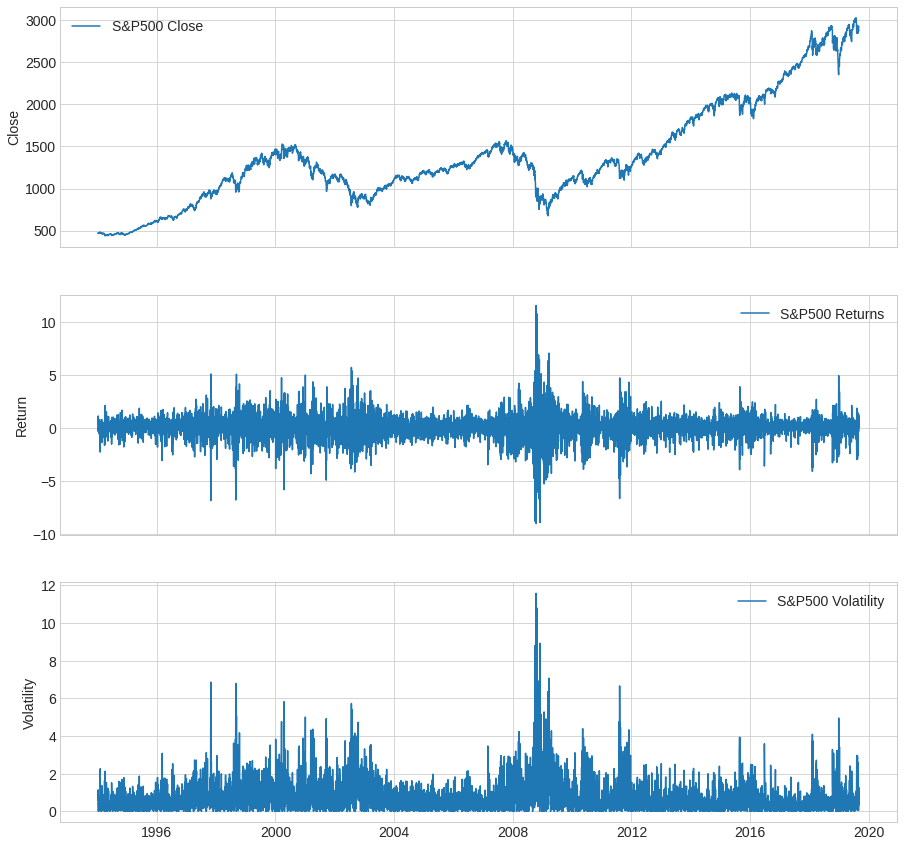

In [13]:
# simple line plots
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(15,15), sharex=True)

axes[0].plot(sp500_df["Close"])
axes[0].legend(["S&P500 Close"], fontsize=14)
axes[0].set_ylabel("Close", fontsize=14)
plt.setp(axes[0].get_xticklabels(), fontsize=14)
plt.setp(axes[0].get_yticklabels(), fontsize=14)

axes[1].plot(sp500_df["Return"])
axes[1].legend(["S&P500 Returns"], fontsize=14)
axes[1].set_ylabel("Return", fontsize=14)
plt.setp(axes[1].get_xticklabels(), fontsize=14)
plt.setp(axes[1].get_yticklabels(), fontsize=14)

axes[2].plot(sp500_df["Volatility"])
axes[2].legend(["S&P500 Volatility"], fontsize=14)
axes[2].set_ylabel("Volatility", fontsize=14)
plt.setp(axes[2].get_xticklabels(), fontsize=14)
plt.setp(axes[2].get_yticklabels(), fontsize=14)

plt.show()

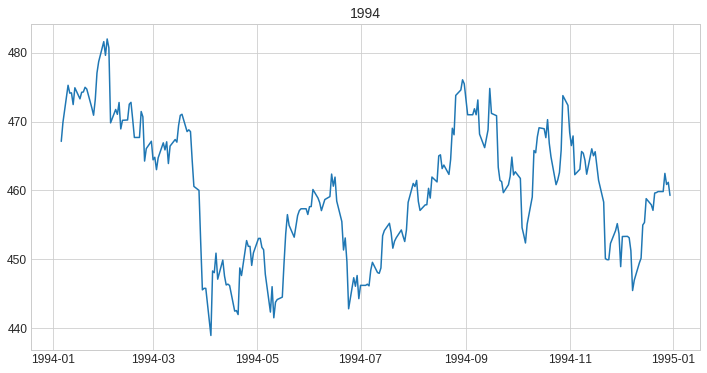

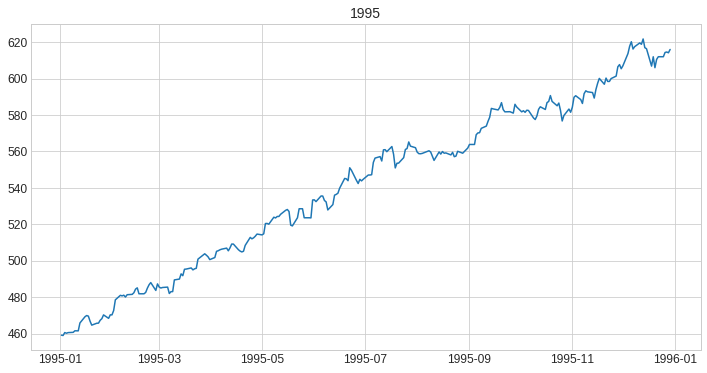

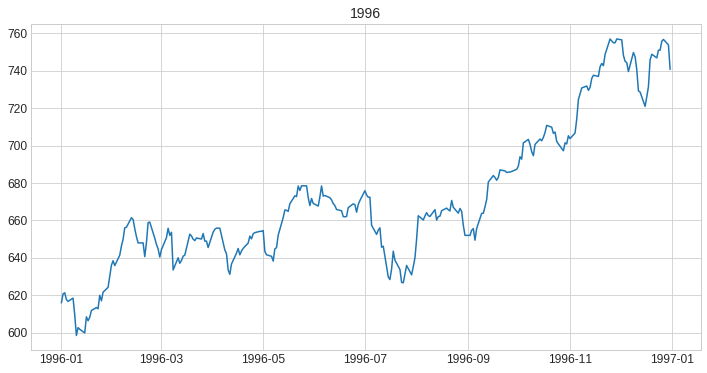

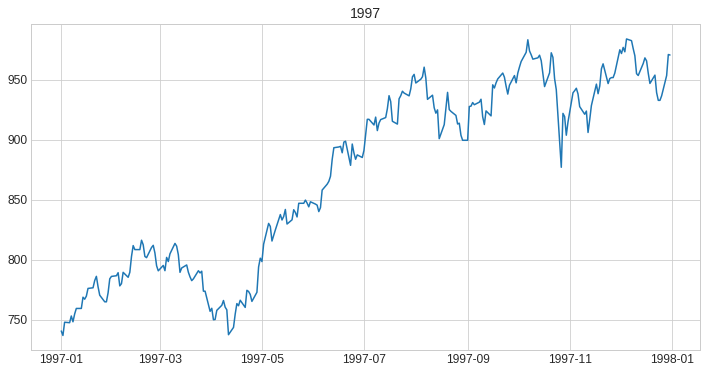

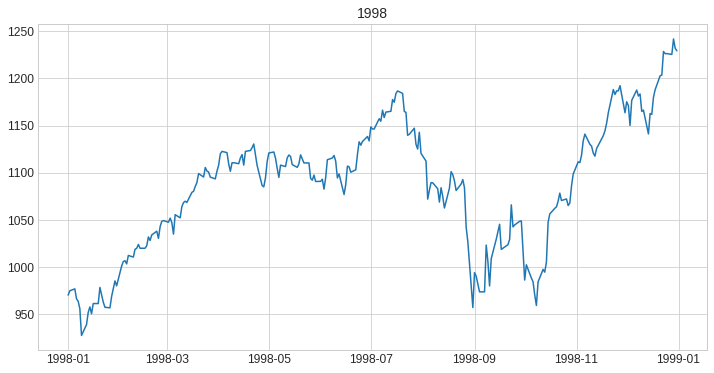

...

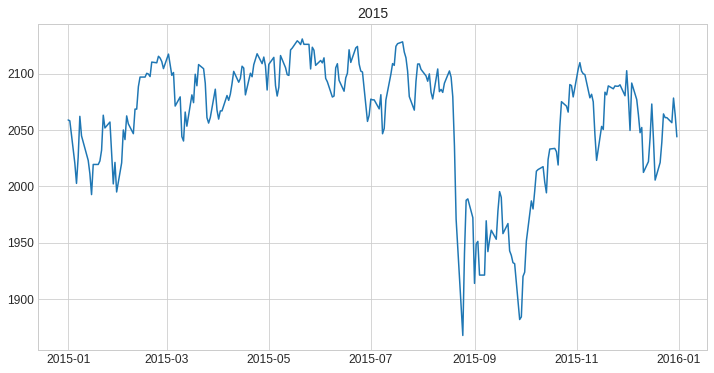

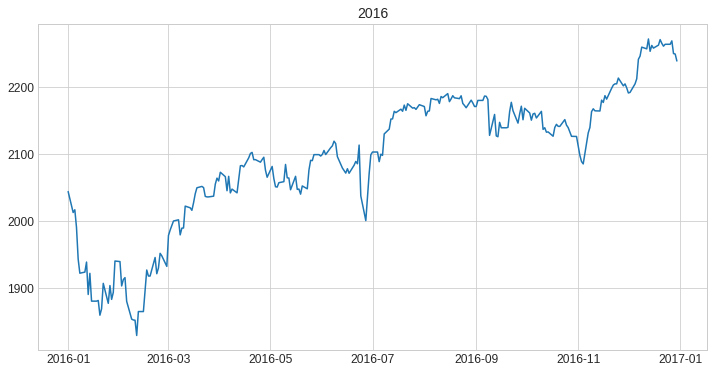

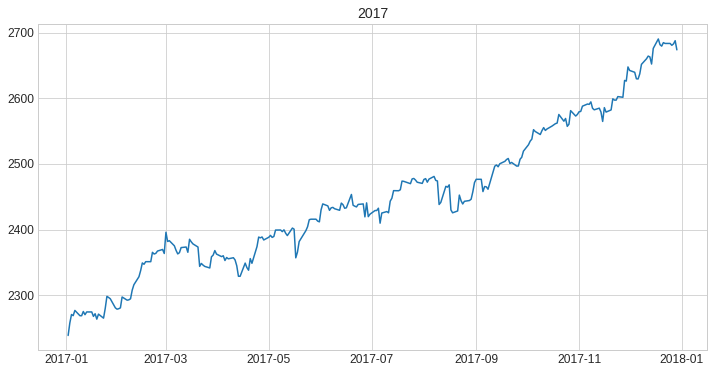

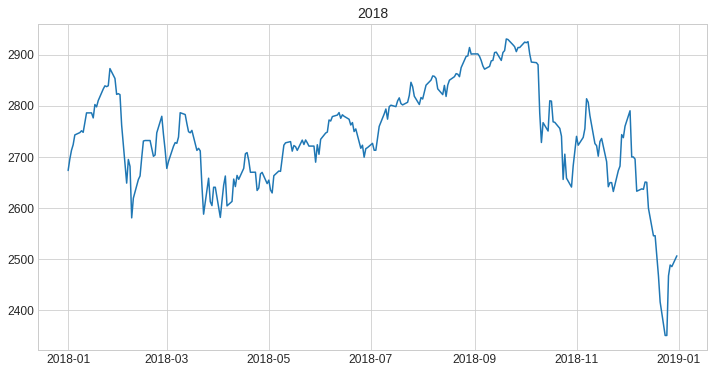

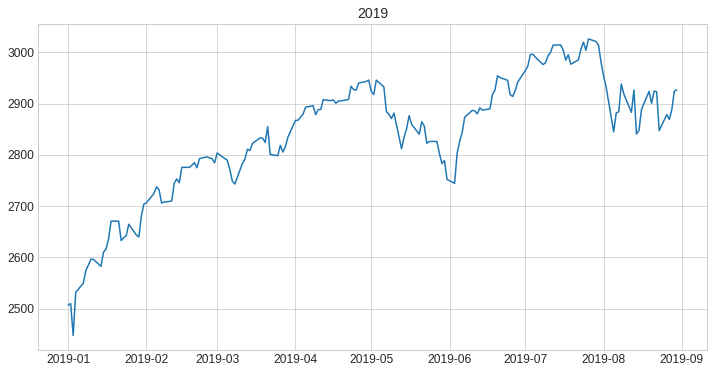

In [14]:
# plot closes by year
for year in set(sp500_df.index.year):
  plt.figure(figsize=(12,6))
  plt.plot(sp500_df["Close"][sp500_df.index.year == year])
  plt.xticks(fontsize=12)
  plt.yticks(fontsize=12)
  plt.title(str(year), fontsize=14)
  plt.show()

### Histograms & Density Plots

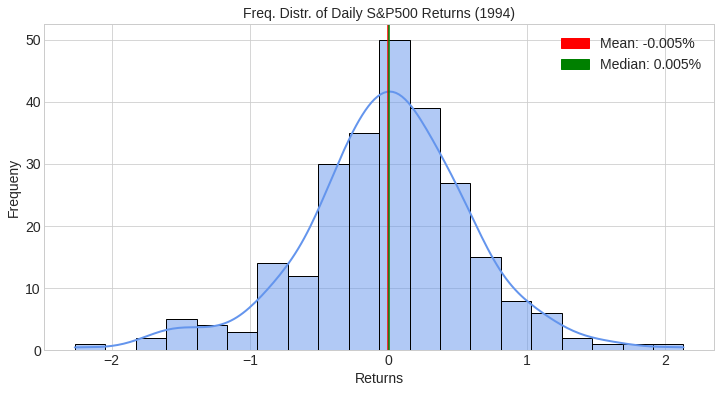

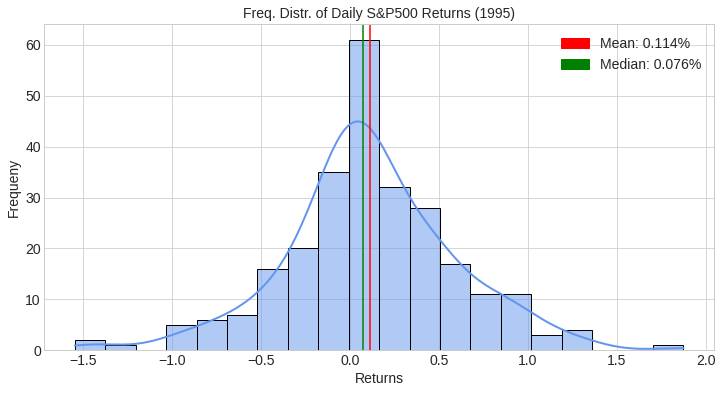

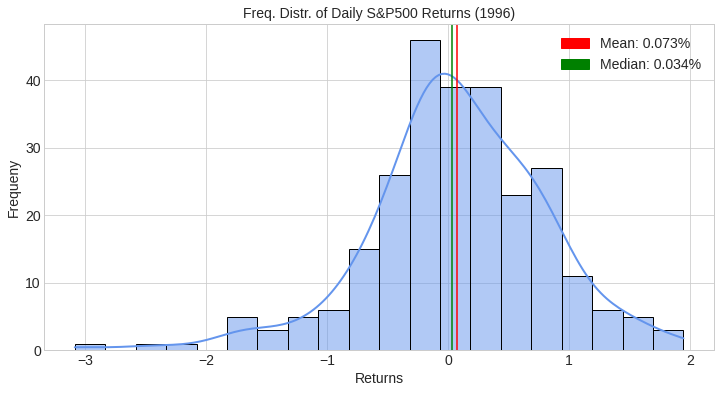

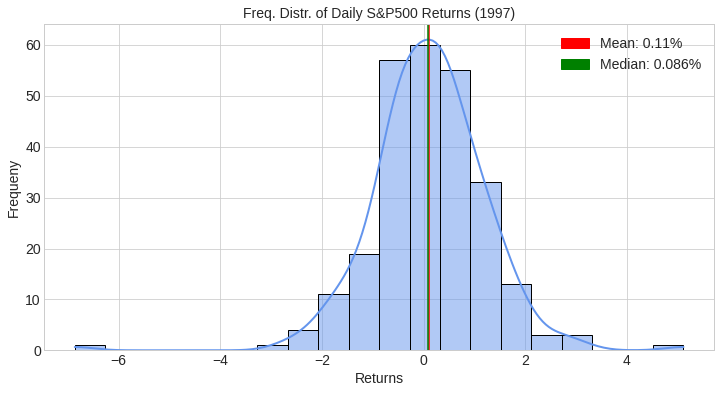

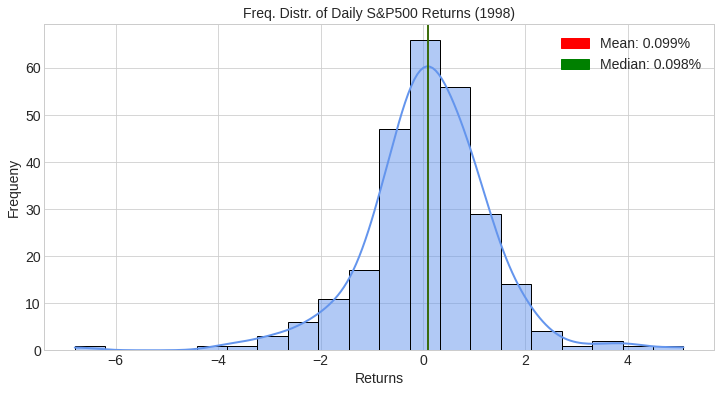

...

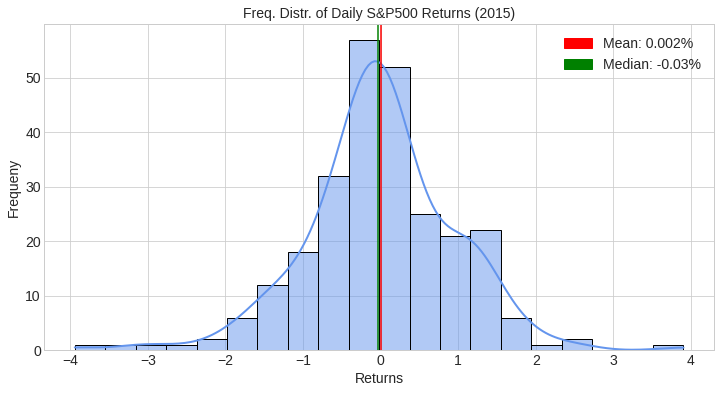

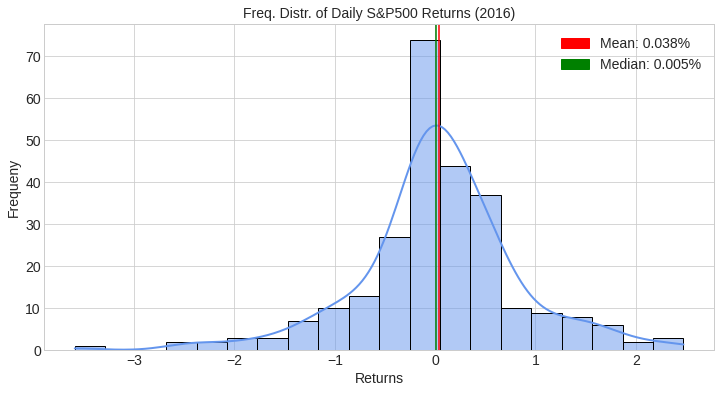

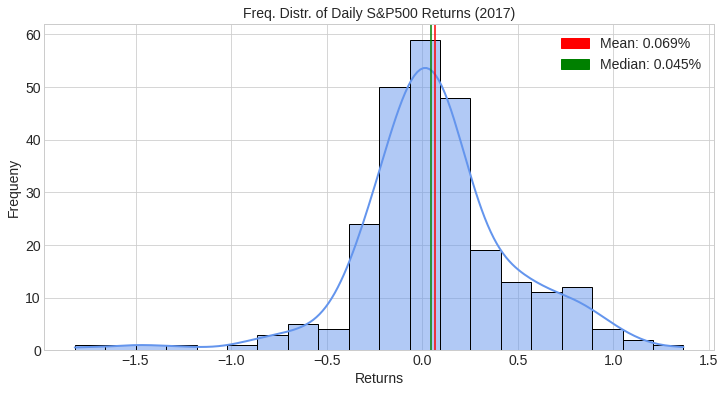

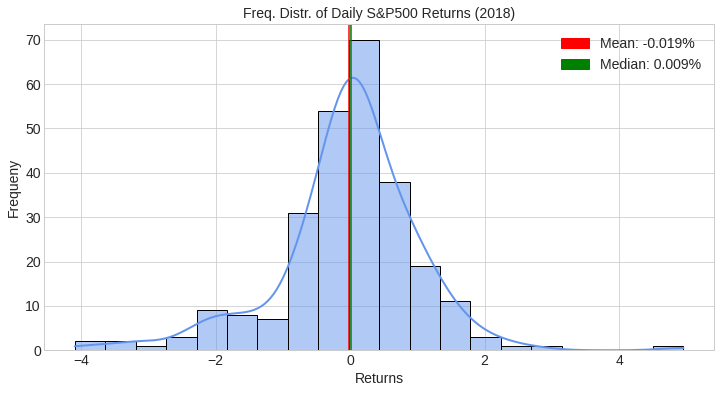

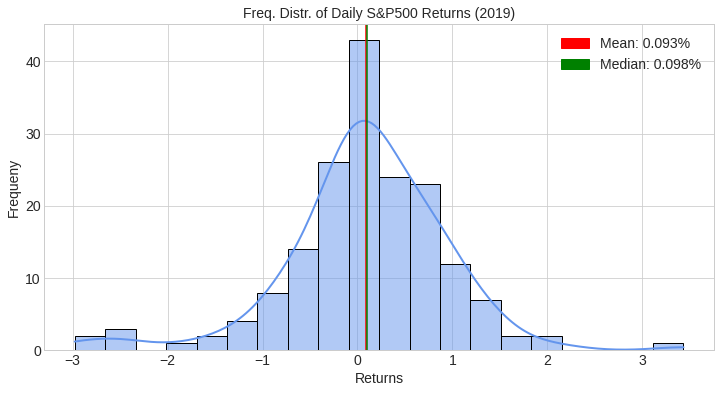

In [15]:
# histogram and density plot of returns

for year in set(sp500_df.index.year):
  plt.figure(figsize=(12,6))

  sns.histplot(data=sp500_df["Return"][sp500_df.index.year == year], 
              kde=True, 
              bins=20,
              color="cornflowerblue",
              line_kws={"linewidth": 2})

  mean = sp500_df["Return"][sp500_df.index.year == year].mean()
  median = sp500_df["Return"][sp500_df.index.year == year].median()
  plt.axvline(x=mean, c="r")
  plt.axvline(x=median, c="g")
  mean_patch = mpatches.Patch(color="r", label="Mean: {}%".format(np.around(mean,3)))
  median_patch = mpatches.Patch(color="g", label="Median: {}%".format(np.around(median,3)))

  plt.legend(handles=[mean_patch, median_patch], fontsize=14)
  plt.xticks(fontsize=14)
  plt.yticks(fontsize=14)
  plt.xlabel("Returns", fontsize=14)
  plt.ylabel("Frequeny", fontsize=14)
  plt.title("Freq. Distr. of Daily S&P500 Returns ({})".format(str(year)), fontsize=14)

  plt.show()

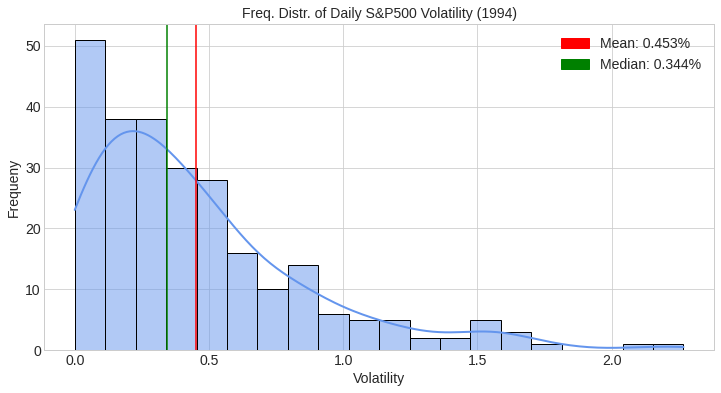

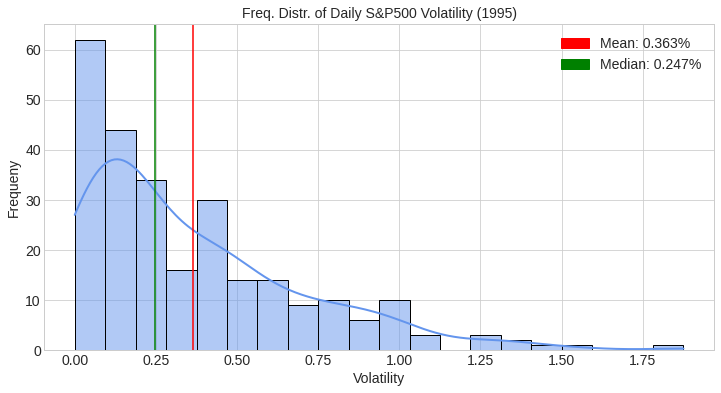

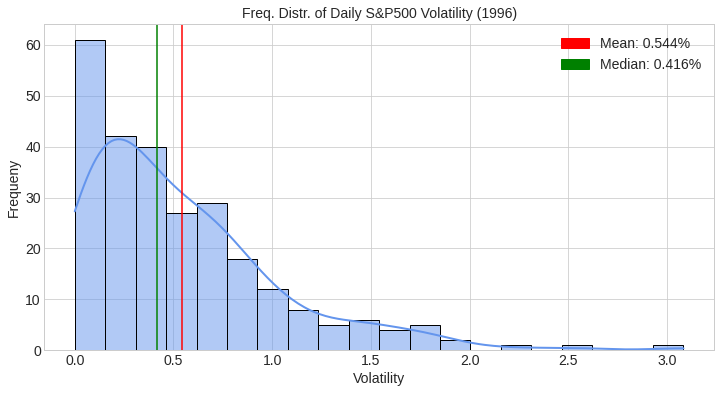

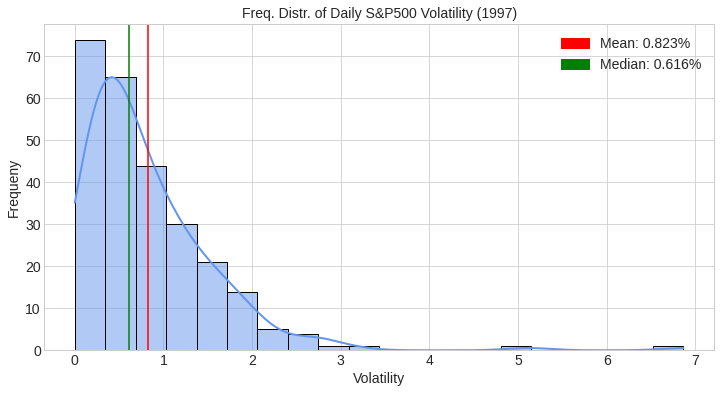

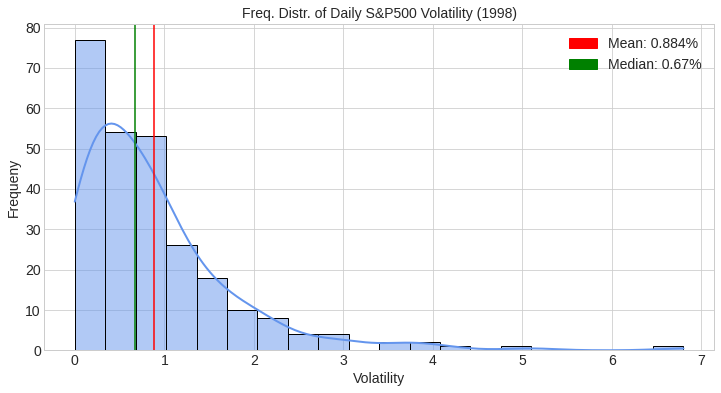

...

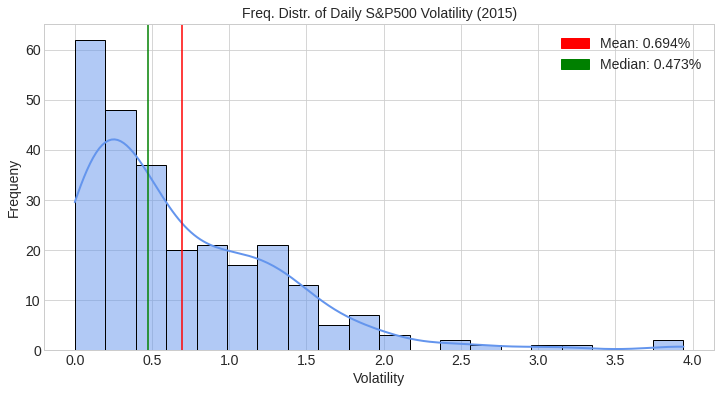

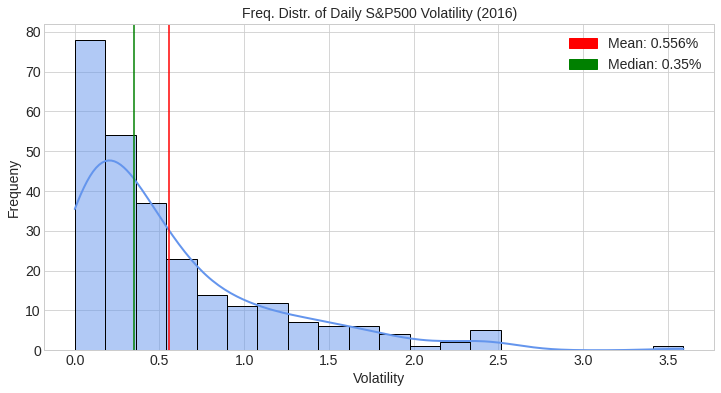

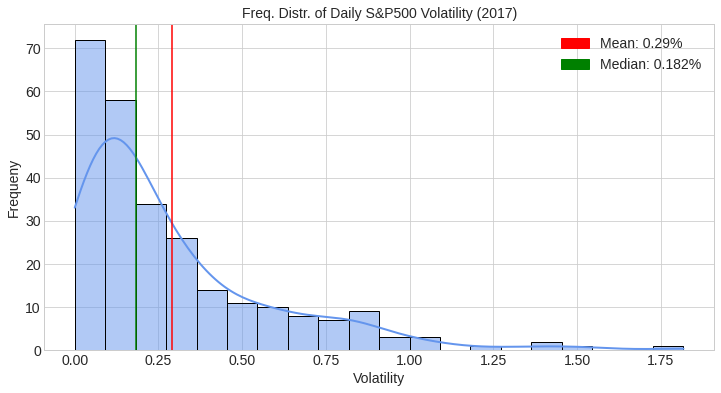

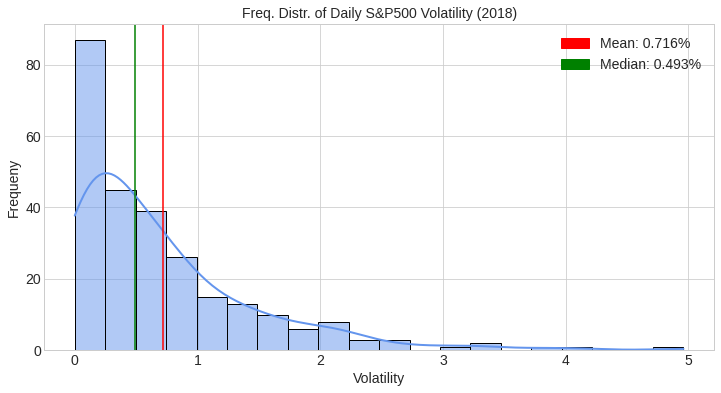

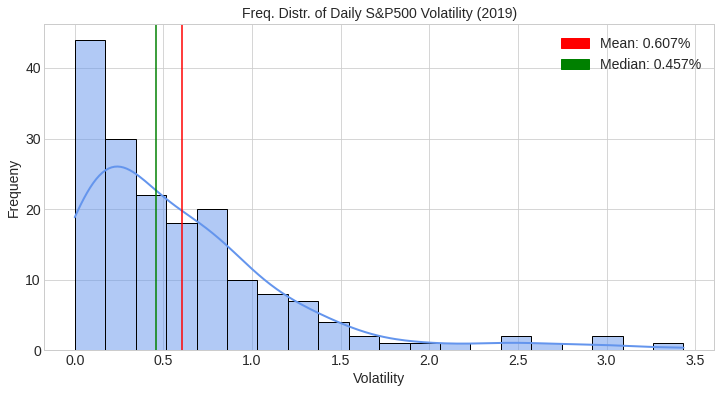

In [16]:
# histogram and density plot of volatility

for year in set(sp500_df.index.year):
  plt.figure(figsize=(12,6))

  sns.histplot(data=sp500_df["Volatility"][sp500_df.index.year == year], 
              kde=True, 
              bins=20,
              color="cornflowerblue",
              line_kws={"linewidth": 2})

  mean = sp500_df["Volatility"][sp500_df.index.year == year].mean()
  median = sp500_df["Volatility"][sp500_df.index.year == year].median()
  plt.axvline(x=mean, c="r")
  plt.axvline(x=median, c="g")
  mean_patch = mpatches.Patch(color="r", label="Mean: {}%".format(np.around(mean,3)))
  median_patch = mpatches.Patch(color="g", label="Median: {}%".format(np.around(median,3)))

  plt.legend(handles=[mean_patch, median_patch], fontsize=14)
  plt.xticks(fontsize=14)
  plt.yticks(fontsize=14)
  plt.xlabel("Volatility", fontsize=14)
  plt.ylabel("Frequeny", fontsize=14)
  plt.title("Freq. Distr. of Daily S&P500 Volatility ({})".format(str(year)), fontsize=14)

  plt.show()

### Box Plots

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is de

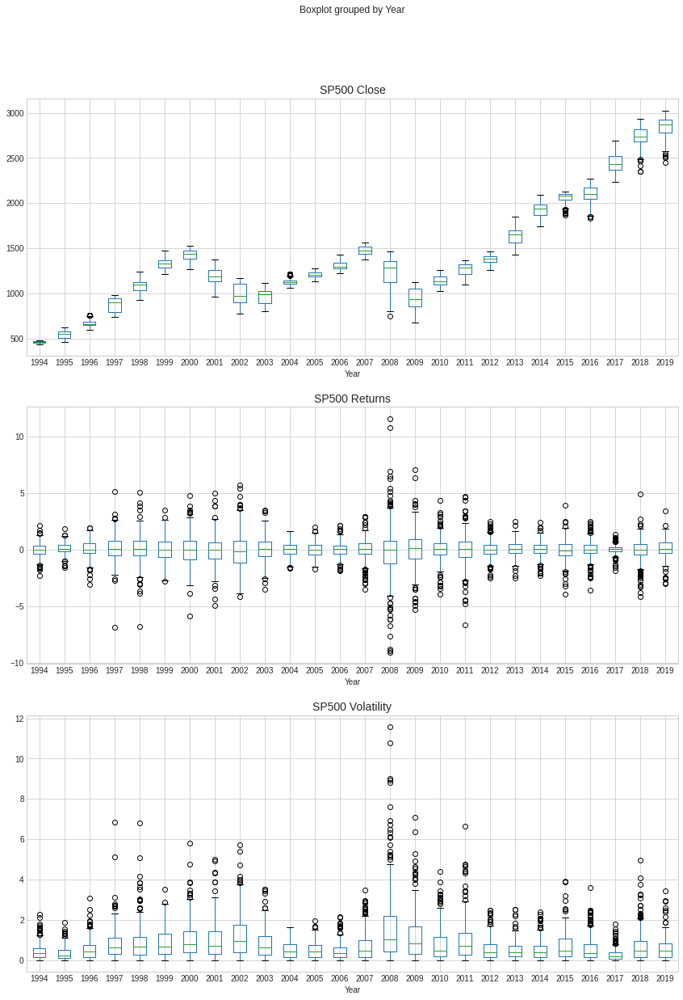

In [17]:
# box plots
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(14, 20))

# closes
sp500_df.boxplot(by="Year", column="Close", ax=axes[0])
axes[0].set_title("SP500 Close", size = 14)
# returns
sp500_df.boxplot(by="Year", column="Return", ax=axes[1])
axes[1].set_title("SP500 Returns", size = 14)
# volatility
sp500_df.boxplot(by="Year", column="Volatility", ax=axes[2])
axes[2].set_title("SP500 Volatility", size = 14)

plt.show()

- The above plots show that SPX prices have a generally upward trend apart from a few dips experienced in early 2000s and near the years of 2008.
- The returns seem fairly steady over the years, but with some major fluctuations during the periods mentioned above.
- Similar pattern is observed in volatility plot as well.

### Autocorrelation & Partial Autocorrelation

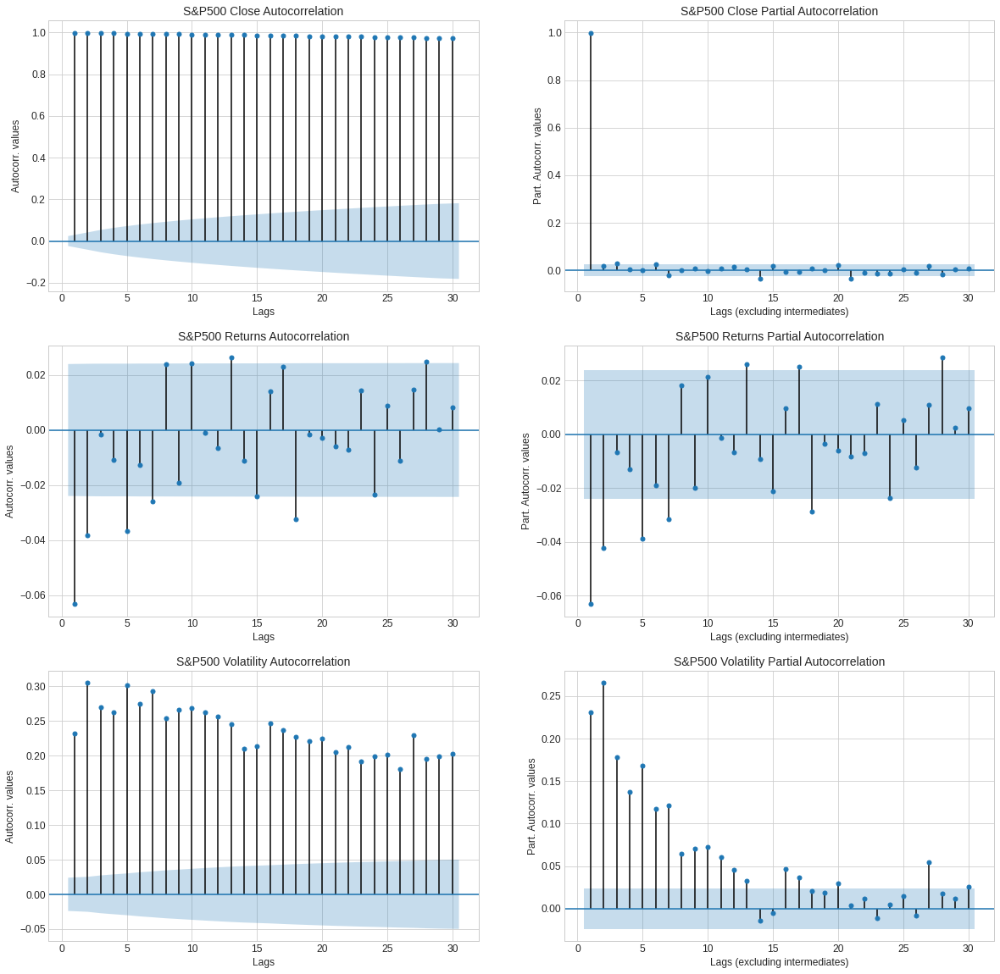

In [18]:
# autocorrelation & partial autocorrelation for last 30 days
fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(20, 20))

# close autocorrelation
plot_acf(sp500_df["Close"].tolist(), zero=False, lags=30, ax=axes[0][0])
axes[0][0].set_title("S&P500 Close Autocorrelation", fontsize=14)
axes[0][0].set_xlabel('Lags', fontsize=12)
axes[0][0].set_ylabel('Autocorr. values', fontsize=12)
plt.setp(axes[0][0].get_xticklabels(), fontsize=12)
plt.setp(axes[0][0].get_yticklabels(), fontsize=12)
# close partial autocorrelation
plot_pacf(sp500_df["Close"].tolist(), zero=False, lags=30, ax=axes[0][1])
axes[0][1].set_title("S&P500 Close Partial Autocorrelation", fontsize=14)
axes[0][1].set_xlabel('Lags (excluding intermediates)', fontsize=12)
axes[0][1].set_ylabel('Part. Autocorr. values', fontsize=12)
plt.setp(axes[0][1].get_xticklabels(), fontsize=12)
plt.setp(axes[0][1].get_yticklabels(), fontsize=12)

# returns autocorrelation
plot_acf(sp500_df["Return"][1:].tolist(), zero=False, lags=30, ax=axes[1][0])
axes[1][0].set_title("S&P500 Returns Autocorrelation", fontsize=14)
axes[1][0].set_xlabel('Lags', fontsize=12)
axes[1][0].set_ylabel('Autocorr. values', fontsize=12)
plt.setp(axes[1][0].get_xticklabels(), fontsize=12)
plt.setp(axes[1][0].get_yticklabels(), fontsize=12)
# returns partial autocorrelation
plot_pacf(sp500_df["Return"][1:].tolist(), zero=False, lags=30, ax=axes[1][1])
axes[1][1].set_title("S&P500 Returns Partial Autocorrelation", fontsize=14)
axes[1][1].set_xlabel('Lags (excluding intermediates)', fontsize=12)
axes[1][1].set_ylabel('Part. Autocorr. values', fontsize=12)
plt.setp(axes[1][1].get_xticklabels(), fontsize=12)
plt.setp(axes[1][1].get_yticklabels(), fontsize=12)

# volatility autocorrelation
plot_acf(sp500_df["Volatility"][1:].tolist(), zero=False, lags=30, ax=axes[2][0])
axes[2][0].set_title("S&P500 Volatility Autocorrelation", fontsize=14)
axes[2][0].set_xlabel('Lags', fontsize=12)
axes[2][0].set_ylabel('Autocorr. values', fontsize=12)
plt.setp(axes[2][0].get_xticklabels(), fontsize=12)
plt.setp(axes[2][0].get_yticklabels(), fontsize=12)
# volatility partial autocorrelation
plot_pacf(sp500_df["Volatility"][1:].tolist(), zero=False, lags=30, ax=axes[2][1])
axes[2][1].set_title("S&P500 Volatility Partial Autocorrelation", fontsize=14)
axes[2][1].set_xlabel('Lags (excluding intermediates)', fontsize=12)
axes[2][1].set_ylabel('Part. Autocorr. values', fontsize=12)
plt.setp(axes[2][1].get_xticklabels(), fontsize=12)
plt.setp(axes[2][1].get_yticklabels(), fontsize=12)

plt.show()

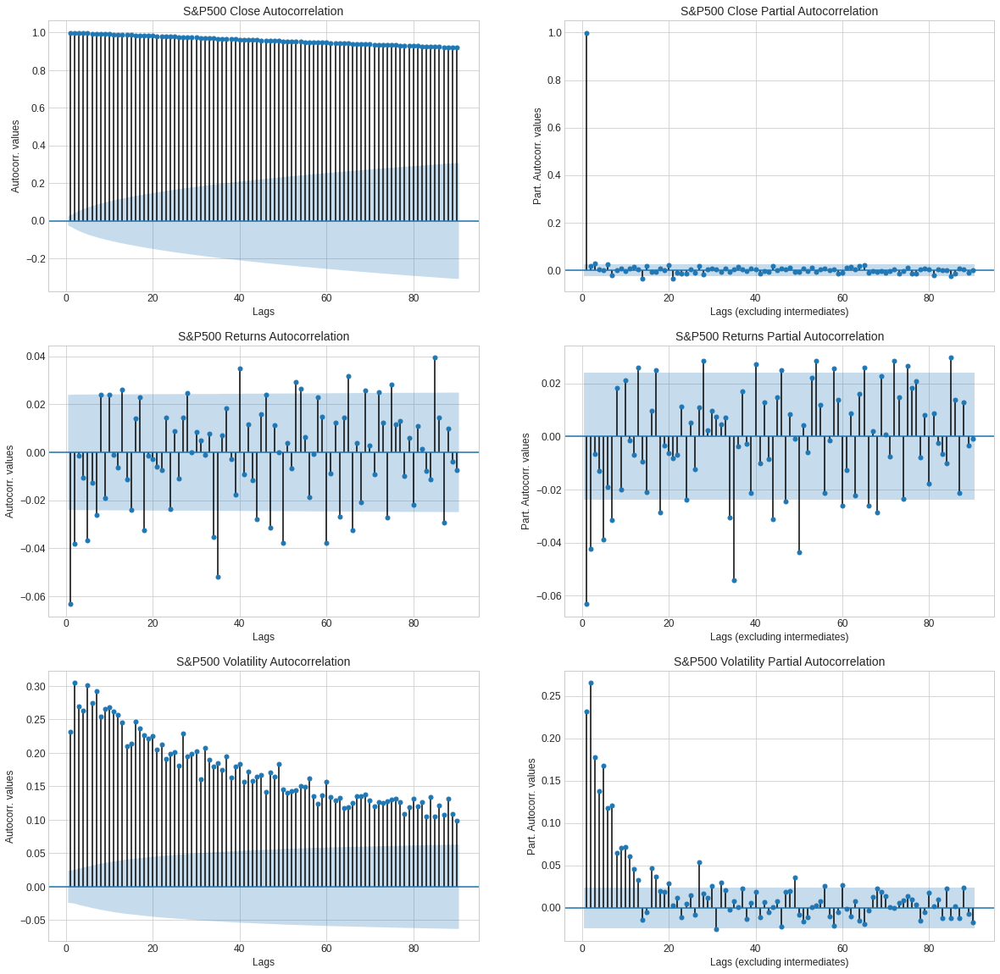

In [19]:
# autocorrelation & partial autocorrelation for last 90 days
fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(20, 20))

# close autocorrelation
plot_acf(sp500_df["Close"].tolist(), zero=False, lags=90, ax=axes[0][0])
axes[0][0].set_title("S&P500 Close Autocorrelation", fontsize=14)
axes[0][0].set_xlabel('Lags', fontsize=12)
axes[0][0].set_ylabel('Autocorr. values', fontsize=12)
plt.setp(axes[0][0].get_xticklabels(), fontsize=12)
plt.setp(axes[0][0].get_yticklabels(), fontsize=12)
# close partial autocorrelation
plot_pacf(sp500_df["Close"].tolist(), zero=False, lags=90, ax=axes[0][1])
axes[0][1].set_title("S&P500 Close Partial Autocorrelation", fontsize=14)
axes[0][1].set_xlabel('Lags (excluding intermediates)', fontsize=12)
axes[0][1].set_ylabel('Part. Autocorr. values', fontsize=12)
plt.setp(axes[0][1].get_xticklabels(), fontsize=12)
plt.setp(axes[0][1].get_yticklabels(), fontsize=12)

# returns autocorrelation
plot_acf(sp500_df["Return"][1:].tolist(), zero=False, lags=90, ax=axes[1][0])
axes[1][0].set_title("S&P500 Returns Autocorrelation", fontsize=14)
axes[1][0].set_xlabel('Lags', fontsize=12)
axes[1][0].set_ylabel('Autocorr. values', fontsize=12)
plt.setp(axes[1][0].get_xticklabels(), fontsize=12)
plt.setp(axes[1][0].get_yticklabels(), fontsize=12)
# returns partial autocorrelation
plot_pacf(sp500_df["Return"][1:].tolist(), zero=False, lags=90, ax=axes[1][1])
axes[1][1].set_title("S&P500 Returns Partial Autocorrelation", fontsize=14)
axes[1][1].set_xlabel('Lags (excluding intermediates)', fontsize=12)
axes[1][1].set_ylabel('Part. Autocorr. values', fontsize=12)
plt.setp(axes[1][1].get_xticklabels(), fontsize=12)
plt.setp(axes[1][1].get_yticklabels(), fontsize=12)

# volatility autocorrelation
plot_acf(sp500_df["Volatility"][1:].tolist(), zero=False, lags=90, ax=axes[2][0])
axes[2][0].set_title("S&P500 Volatility Autocorrelation", fontsize=14)
axes[2][0].set_xlabel('Lags', fontsize=12)
axes[2][0].set_ylabel('Autocorr. values', fontsize=12)
plt.setp(axes[2][0].get_xticklabels(), fontsize=12)
plt.setp(axes[2][0].get_yticklabels(), fontsize=12)
# volatility partial autocorrelation
plot_pacf(sp500_df["Volatility"][1:].tolist(), zero=False, lags=90, ax=axes[2][1])
axes[2][1].set_title("S&P500 Volatility Partial Autocorrelation", fontsize=14)
axes[2][1].set_xlabel('Lags (excluding intermediates)', fontsize=12)
axes[2][1].set_ylabel('Part. Autocorr. values', fontsize=12)
plt.setp(axes[2][1].get_xticklabels(), fontsize=12)
plt.setp(axes[2][1].get_yticklabels(), fontsize=12)

plt.show()

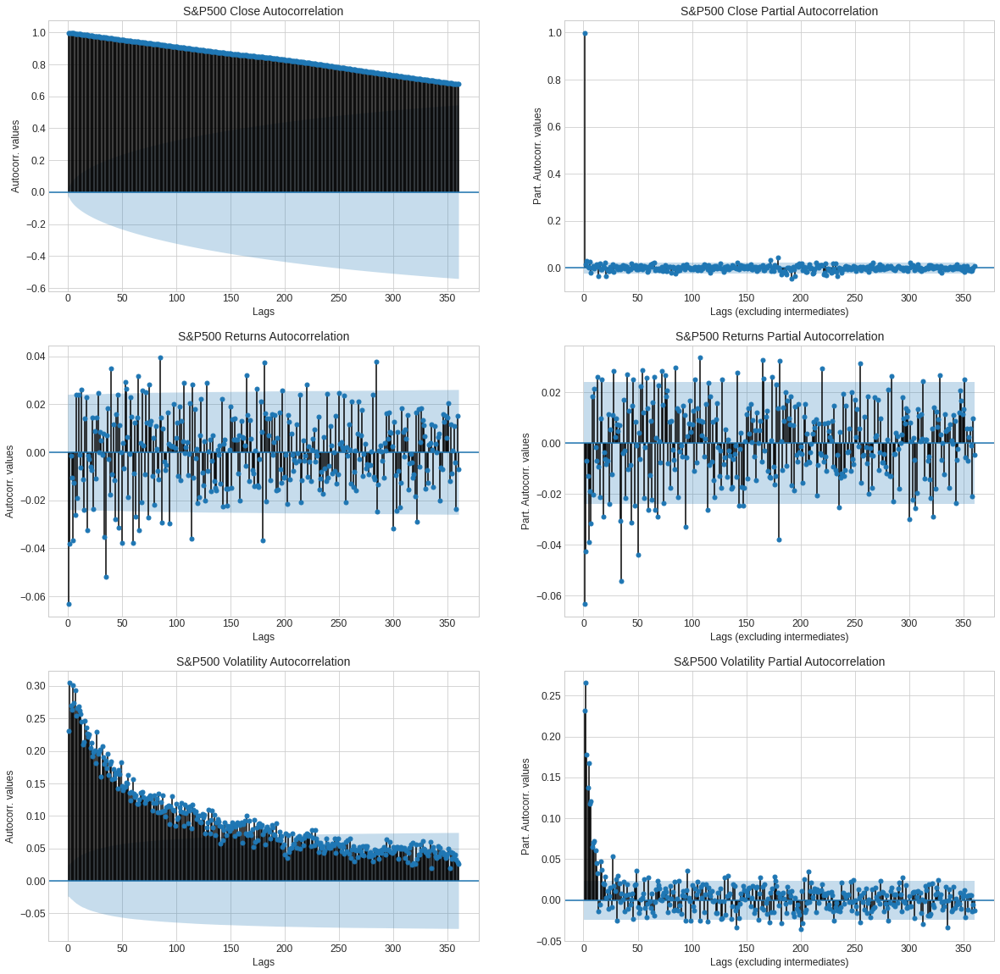

In [20]:
# autocorrelation & partial autocorrelation for last 360 days
fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(20, 20))

# close autocorrelation
plot_acf(sp500_df["Close"].tolist(), zero=False, lags=360, ax=axes[0][0])
axes[0][0].set_title("S&P500 Close Autocorrelation", fontsize=14)
axes[0][0].set_xlabel('Lags', fontsize=12)
axes[0][0].set_ylabel('Autocorr. values', fontsize=12)
plt.setp(axes[0][0].get_xticklabels(), fontsize=12)
plt.setp(axes[0][0].get_yticklabels(), fontsize=12)
# close partial autocorrelation
plot_pacf(sp500_df["Close"].tolist(), zero=False, lags=360, ax=axes[0][1])
axes[0][1].set_title("S&P500 Close Partial Autocorrelation", fontsize=14)
axes[0][1].set_xlabel('Lags (excluding intermediates)', fontsize=12)
axes[0][1].set_ylabel('Part. Autocorr. values', fontsize=12)
plt.setp(axes[0][1].get_xticklabels(), fontsize=12)
plt.setp(axes[0][1].get_yticklabels(), fontsize=12)

# returns autocorrelation
plot_acf(sp500_df["Return"][1:].tolist(), zero=False, lags=360, ax=axes[1][0])
axes[1][0].set_title("S&P500 Returns Autocorrelation", fontsize=14)
axes[1][0].set_xlabel('Lags', fontsize=12)
axes[1][0].set_ylabel('Autocorr. values', fontsize=12)
plt.setp(axes[1][0].get_xticklabels(), fontsize=12)
plt.setp(axes[1][0].get_yticklabels(), fontsize=12)
# returns partial autocorrelation
plot_pacf(sp500_df["Return"][1:].tolist(), zero=False, lags=360, ax=axes[1][1])
axes[1][1].set_title("S&P500 Returns Partial Autocorrelation", fontsize=14)
axes[1][1].set_xlabel('Lags (excluding intermediates)', fontsize=12)
axes[1][1].set_ylabel('Part. Autocorr. values', fontsize=12)
plt.setp(axes[1][1].get_xticklabels(), fontsize=12)
plt.setp(axes[1][1].get_yticklabels(), fontsize=12)

# volatility autocorrelation
plot_acf(sp500_df["Volatility"][1:].tolist(), zero=False, lags=360, ax=axes[2][0])
axes[2][0].set_title("S&P500 Volatility Autocorrelation", fontsize=14)
axes[2][0].set_xlabel('Lags', fontsize=12)
axes[2][0].set_ylabel('Autocorr. values', fontsize=12)
plt.setp(axes[2][0].get_xticklabels(), fontsize=12)
plt.setp(axes[2][0].get_yticklabels(), fontsize=12)
# volatility partial autocorrelation
plot_pacf(sp500_df["Volatility"][1:].tolist(), zero=False, lags=360, ax=axes[2][1])
axes[2][1].set_title("S&P500 Volatility Partial Autocorrelation", fontsize=14)
axes[2][1].set_xlabel('Lags (excluding intermediates)', fontsize=12)
axes[2][1].set_ylabel('Part. Autocorr. values', fontsize=12)
plt.setp(axes[2][1].get_xticklabels(), fontsize=12)
plt.setp(axes[2][1].get_yticklabels(), fontsize=12)

plt.show()


ACF:
- Lagged S&P500 closes are strogly correlated. The correlation is persistent even after a year.
- Lagged S&P500 Returns are correlated initially. Then the correlation spikes up only in certain pockets which may indicate that the data shows some correlation with data that is observed some (meaningful) time previously. Such as, a week, a month, a quarter, a half year or a full year. The reason for the spikes to not be present in lags that are at multiples of 30 is - the months in this dataset do not have 30 days as we are storing values only for business days (5 days a week).
- Lagged versions of S&P500 Volatility are, like lagged S&P500 close, strongly correlated for a long initial period. Then the correlation reduces and spikes up again at a later stage. This stage may also correspond to some lags that are at a meaningful time duration apart from the dataset (like in the case of lagged S&P500 Returns).

PACF:
- Unlike what the ACF plots suggested, Lagged S&P500 closes are strongly correlated for the first lag only. The subsequent lags do not bring in any new information.
- Like ACF plots, PACF plots of Lagged S&P500 Returns are correlated initially. Then the correlation spikes up only in certain meaningful lags (like a week, month etc).
- Like ACF plots, PACF plots of Lagged versions of S&P500 Volatility are strogly correlated for a long initial period. Then the correlation reduces and spikes up again at a later stage (similar to the previous observations).

## 1.4) Decomposition

In [21]:
# plot decomposition
def plot_decomposition(decomposition, axes, title=""):
  axes[0].set_title(title, fontsize=14)
  decomposition.observed.plot(ax=axes[0], legend=False)
  axes[0].set_ylabel('Observed')
  decomposition.trend.plot(ax=axes[1], legend=False)
  axes[1].set_ylabel('Trend')
  decomposition.seasonal.plot(ax=axes[2], legend=False)
  axes[2].set_ylabel('Seasonal')
  decomposition.resid.plot(ax=axes[3], legend=False)
  axes[3].set_ylabel('Residual')
  plt.show()

### Additive Decomposition

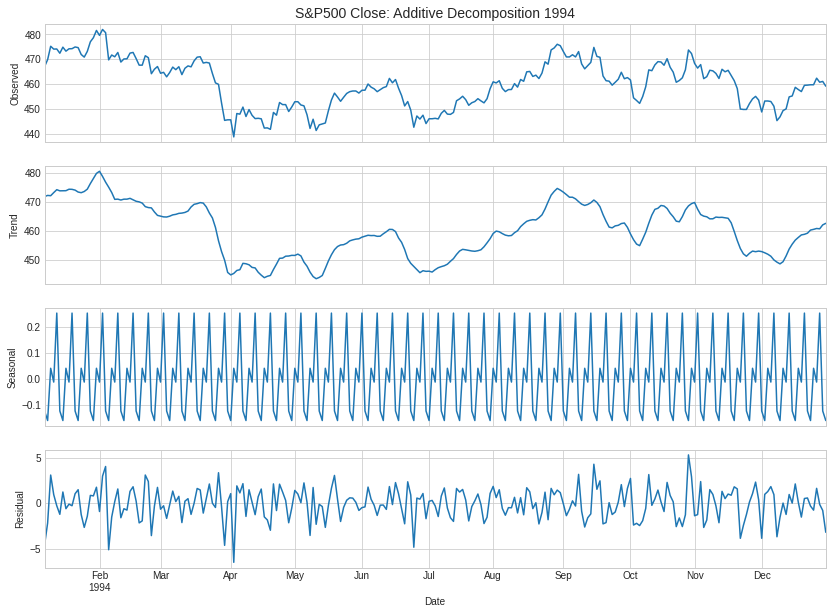

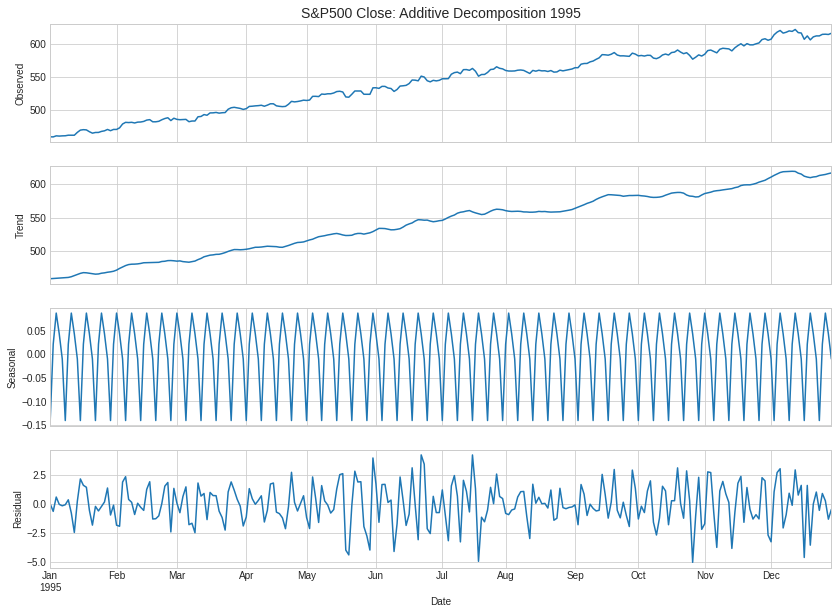

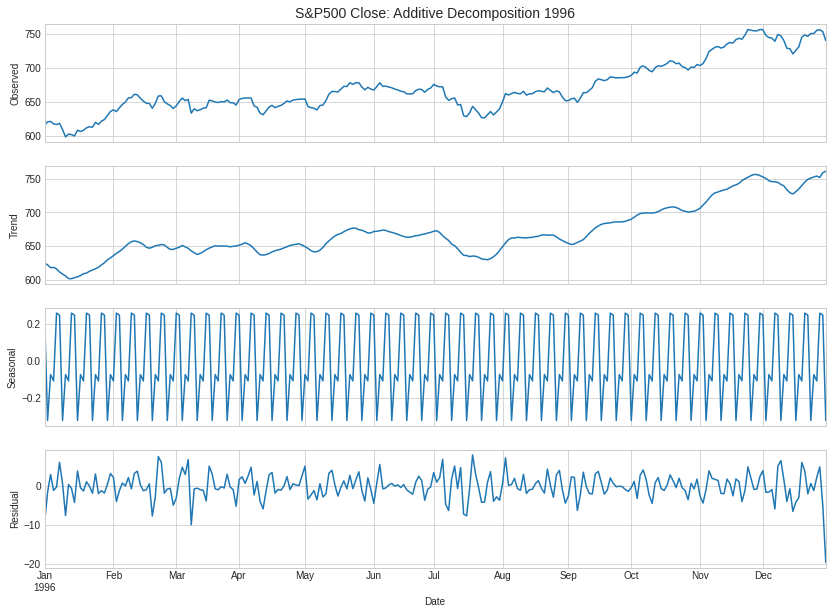

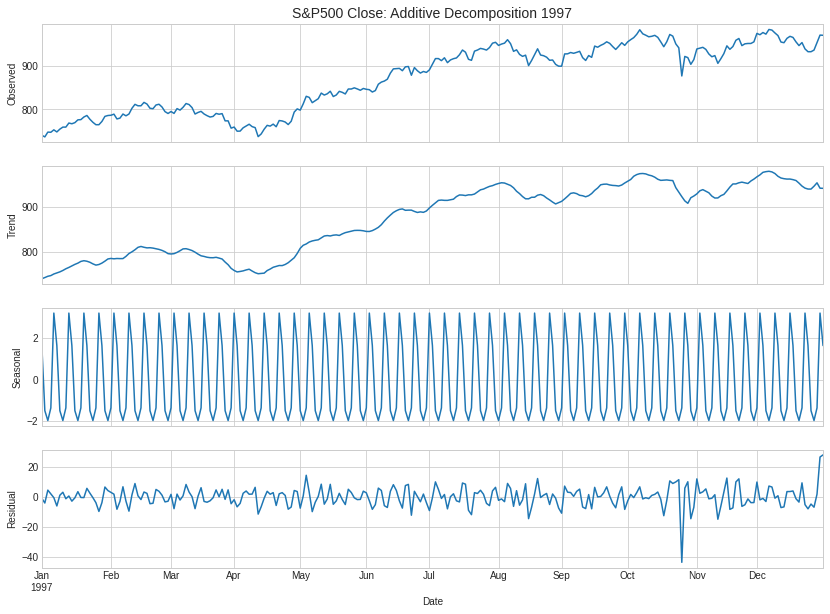

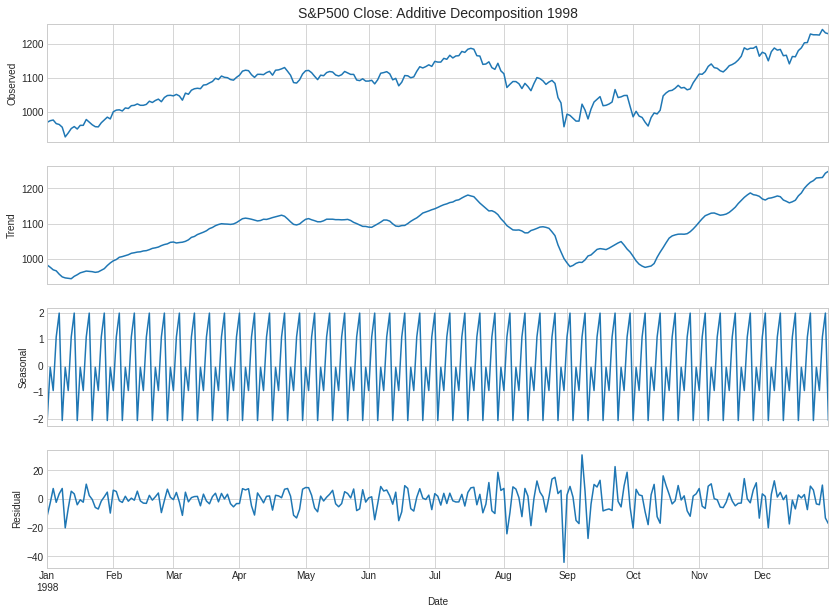

...

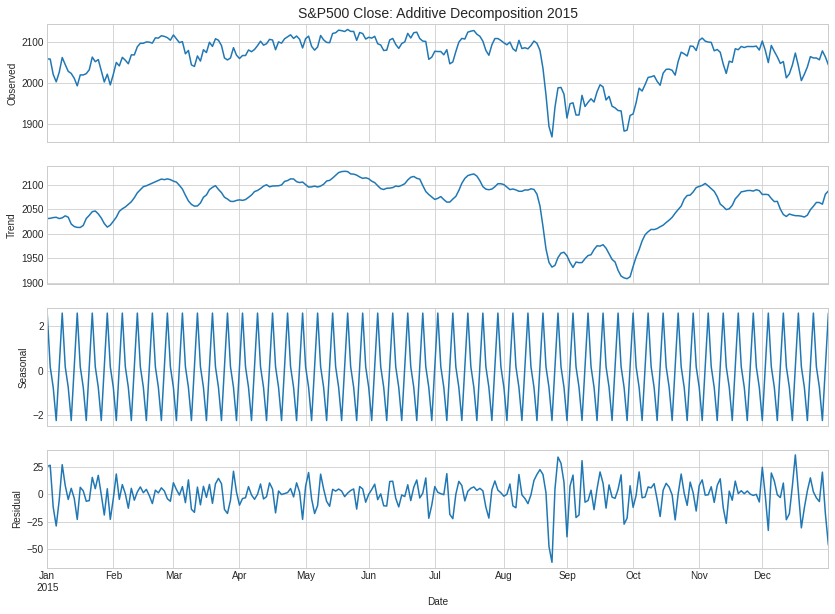

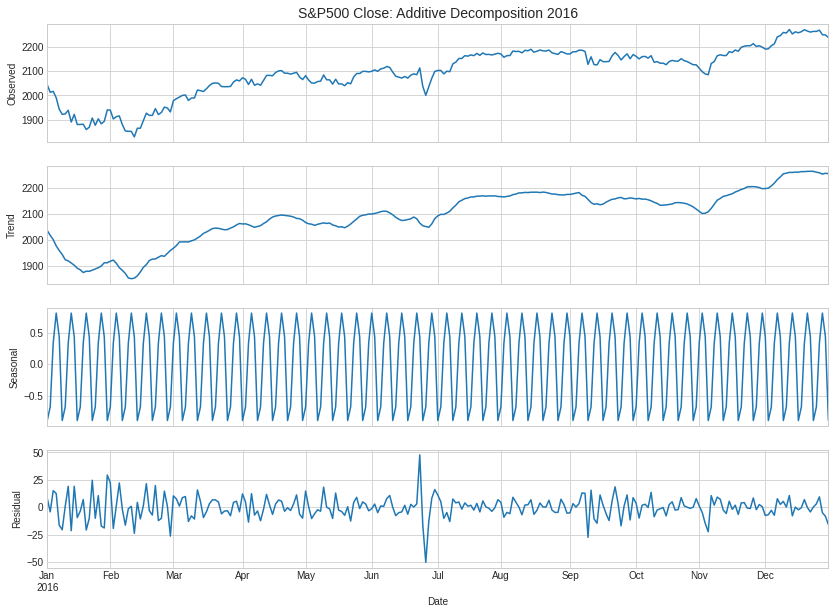

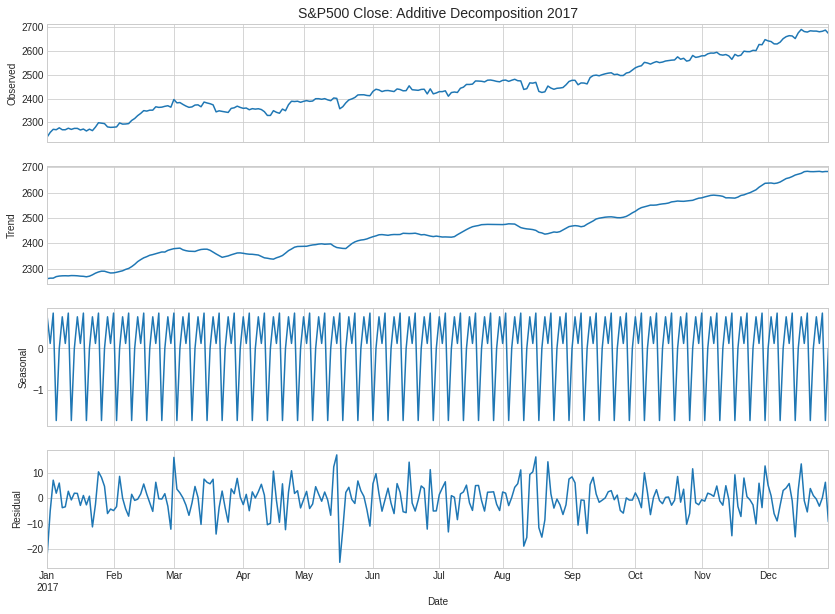

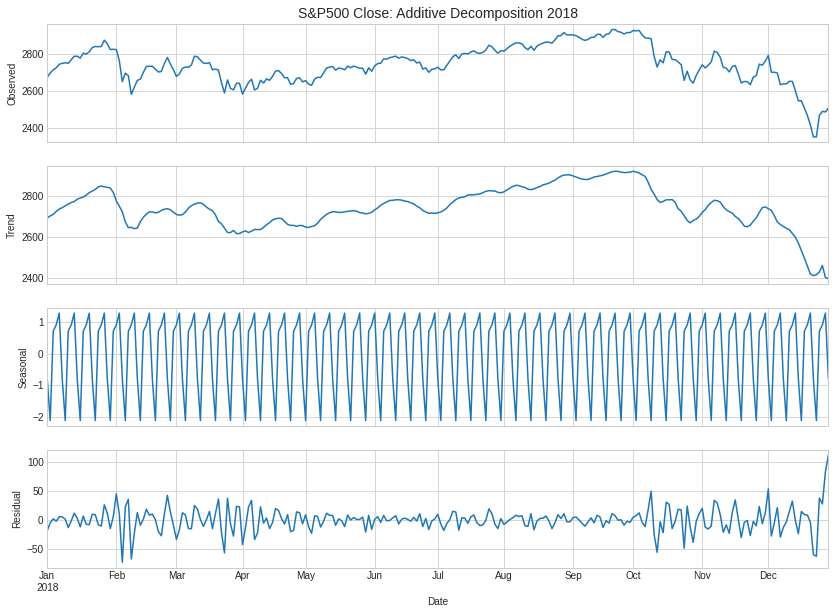

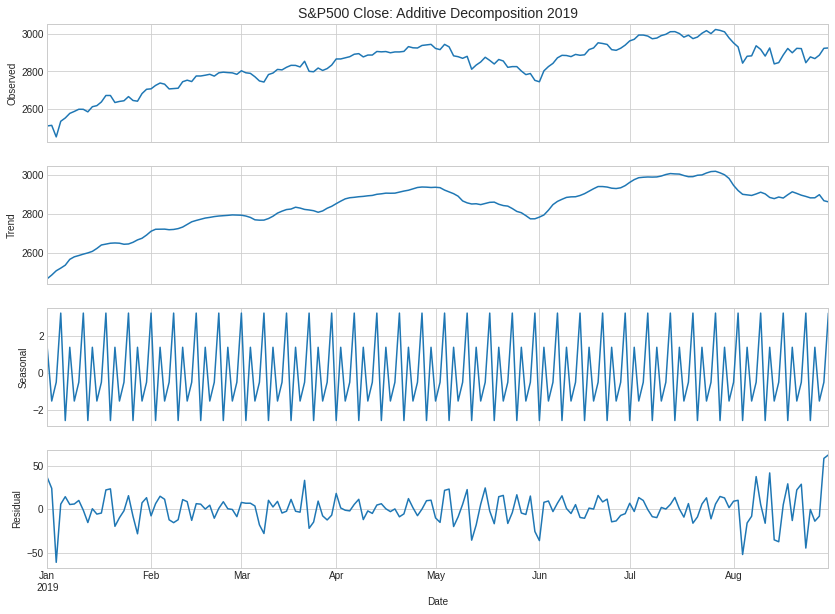

In [22]:
# plot additive decomposition of close by year
for year in set(sp500_df.index.year):
  addi_decomp = seasonal_decompose(sp500_df["Close"][sp500_df.index.year == year], model="additive", extrapolate_trend="freq")
  fig, axes = plt.subplots(nrows=4, ncols=1, sharex=True, figsize=(14,10))
  plot_decomposition(addi_decomp, axes, "S&P500 Close: Additive Decomposition {}".format(str(year)))
  plt.show()

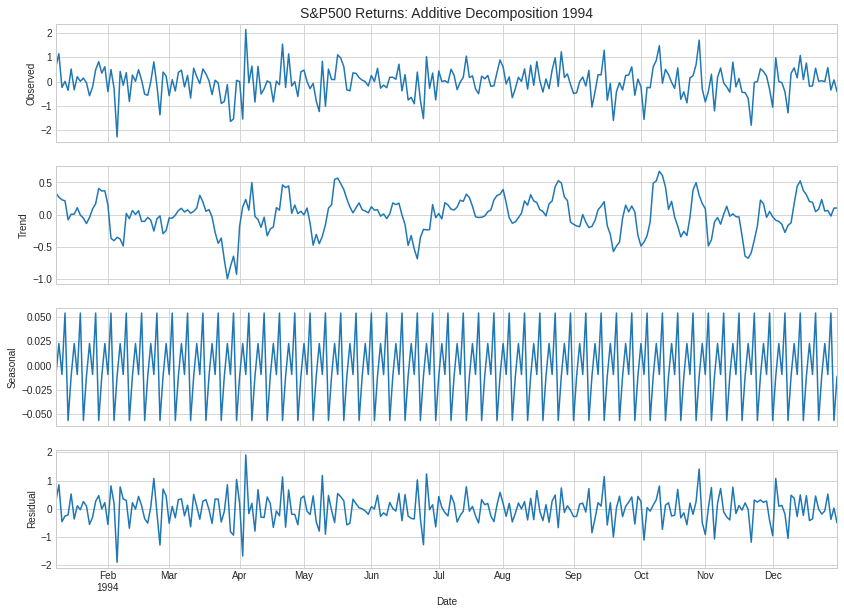

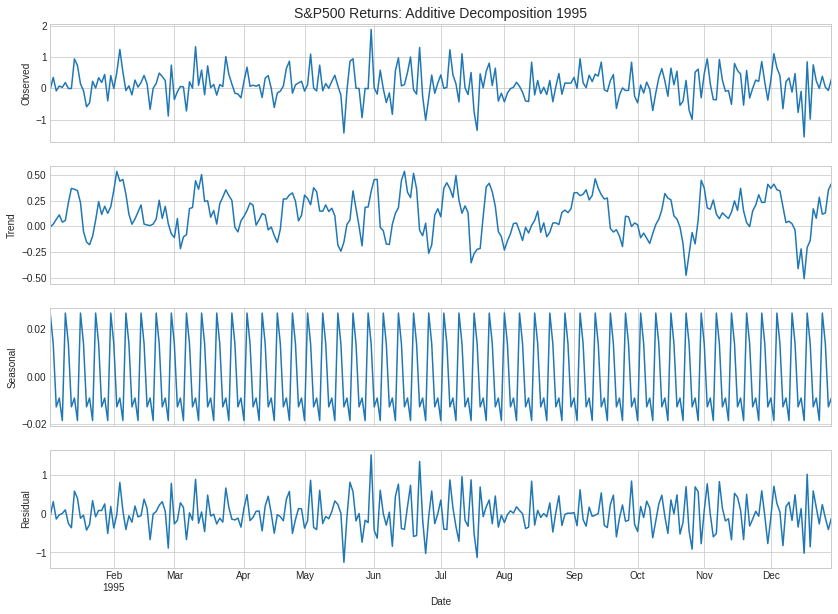

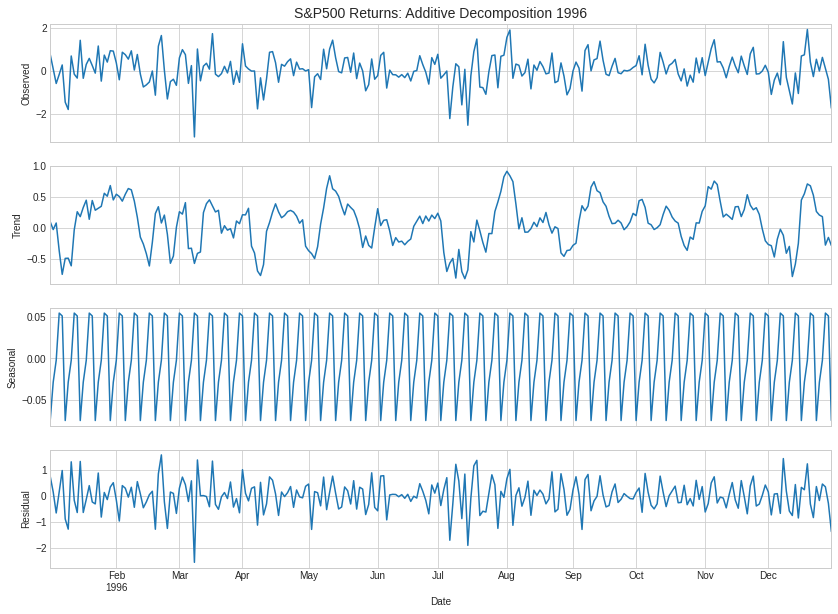

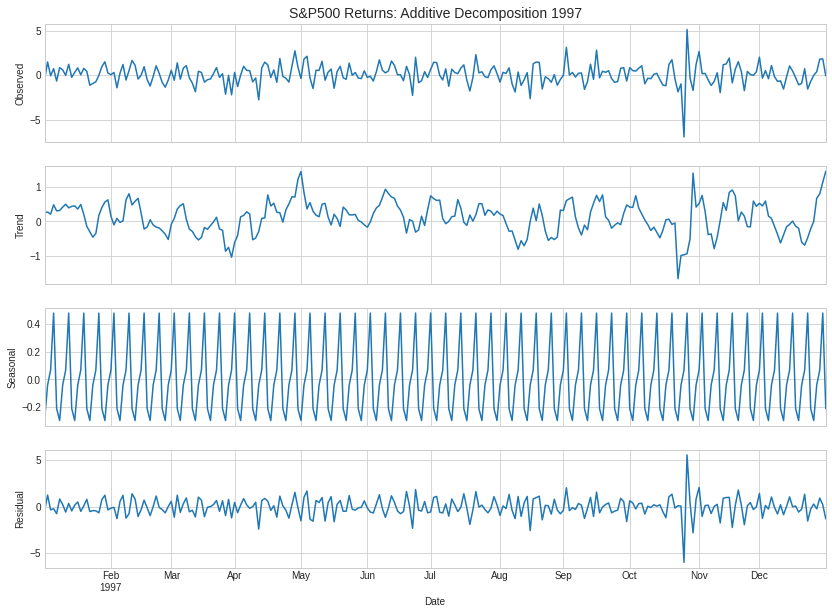

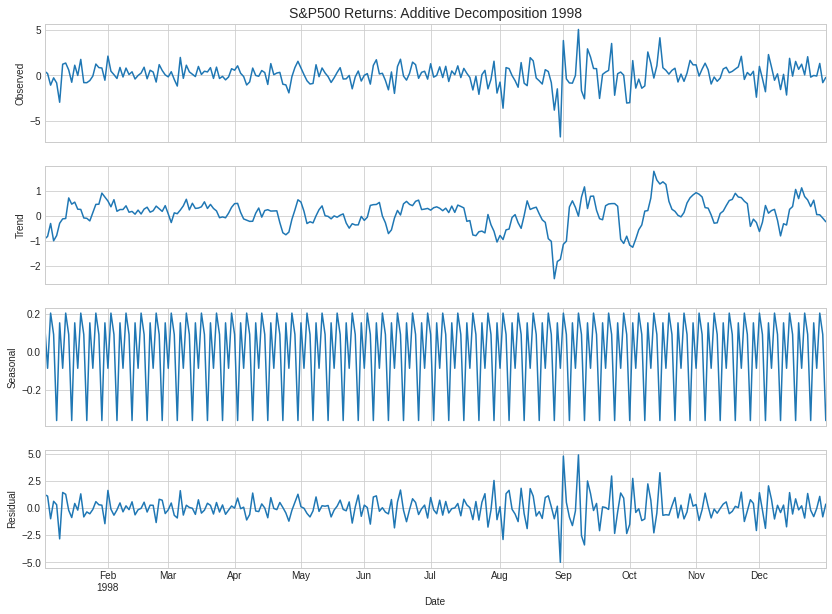

...

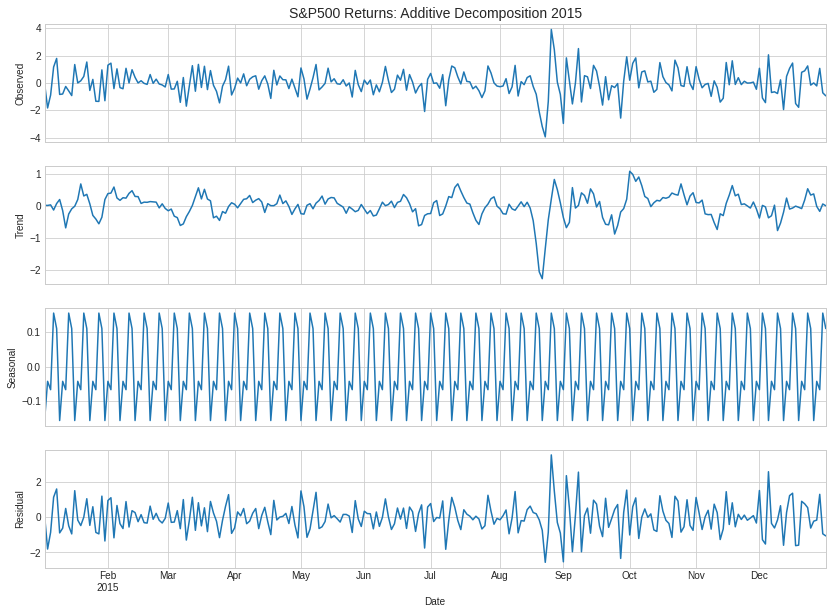

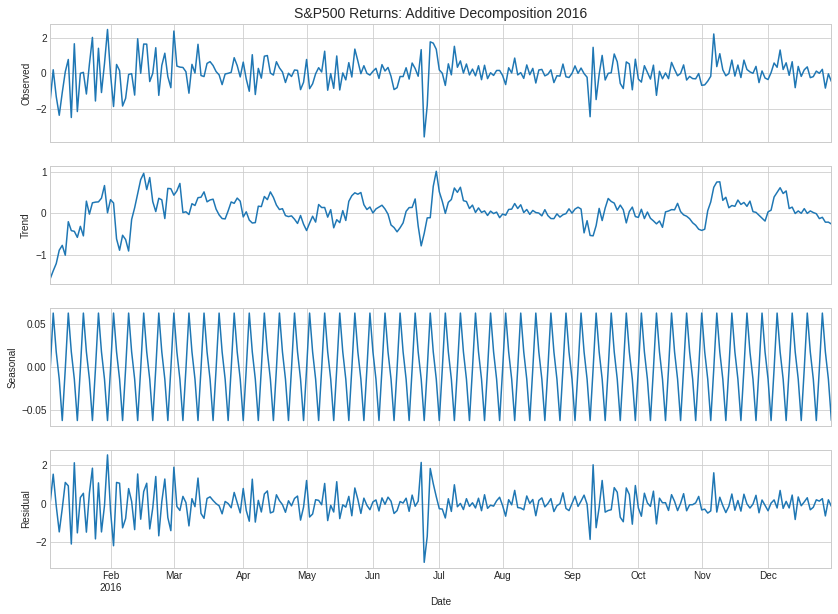

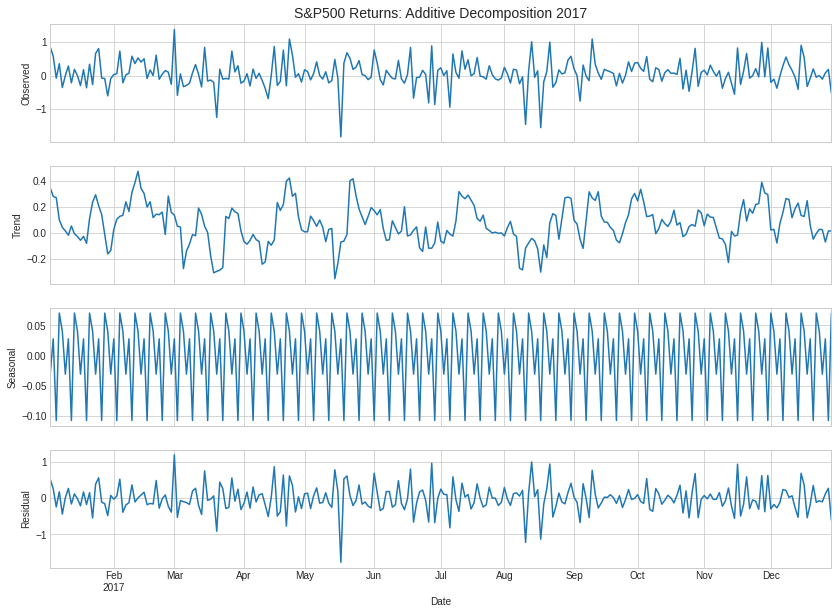

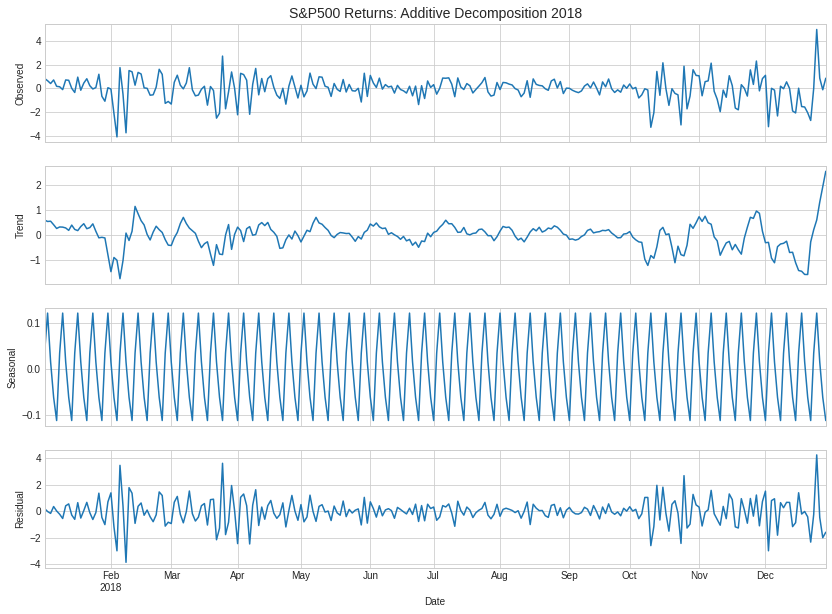

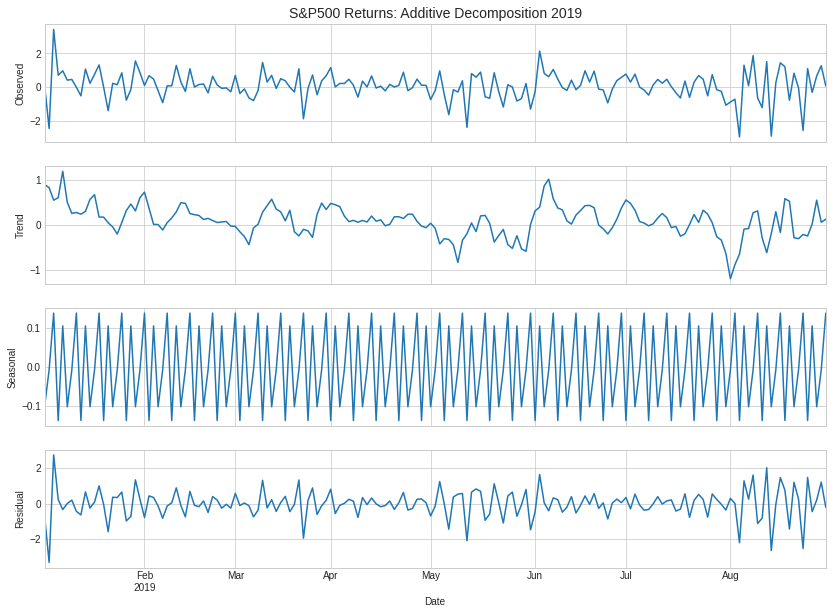

In [23]:
# plot additive decomposition of returns by year
for year in set(sp500_df.index.year):
  addi_decomp = seasonal_decompose(sp500_df["Return"][sp500_df.index.year == year][1:], model="additive", extrapolate_trend="freq")
  fig, axes = plt.subplots(nrows=4, ncols=1, sharex=True, figsize=(14,10))
  plot_decomposition(addi_decomp, axes, "S&P500 Returns: Additive Decomposition {}".format(str(year)))
  plt.show()

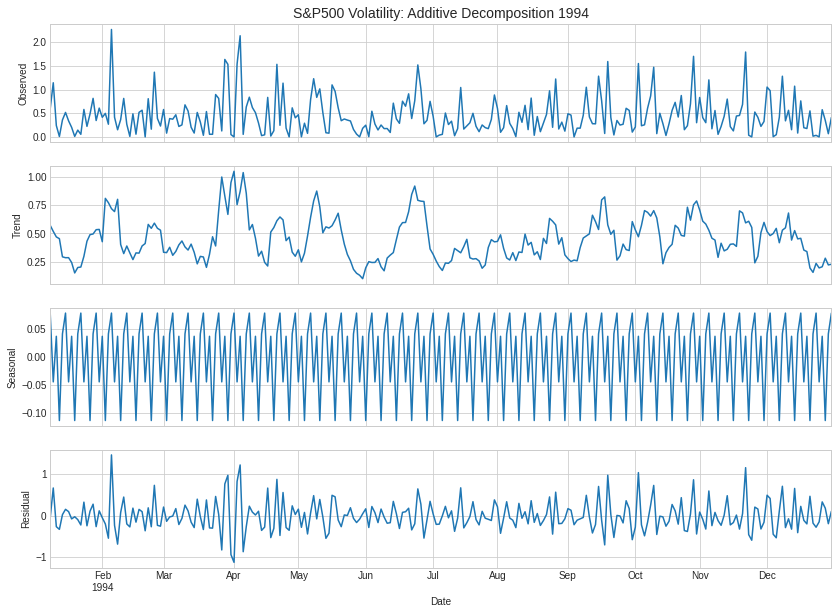

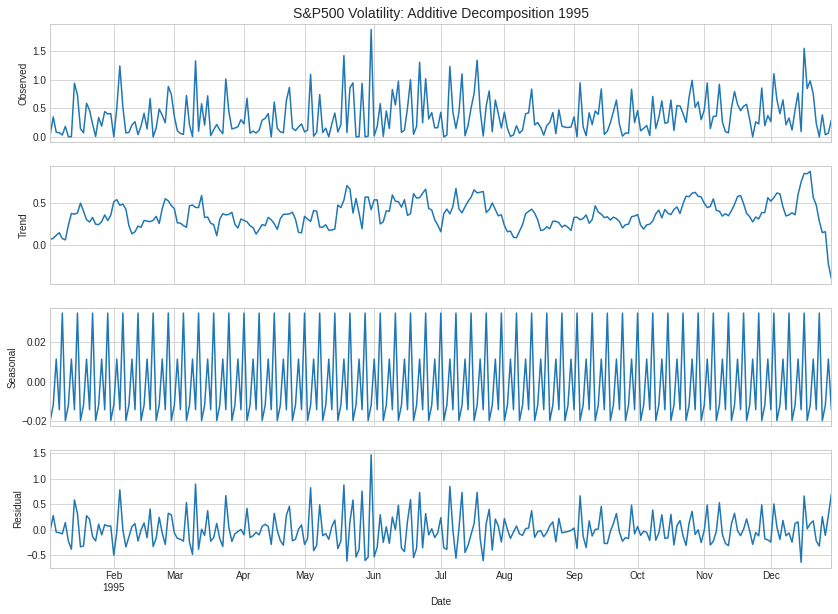

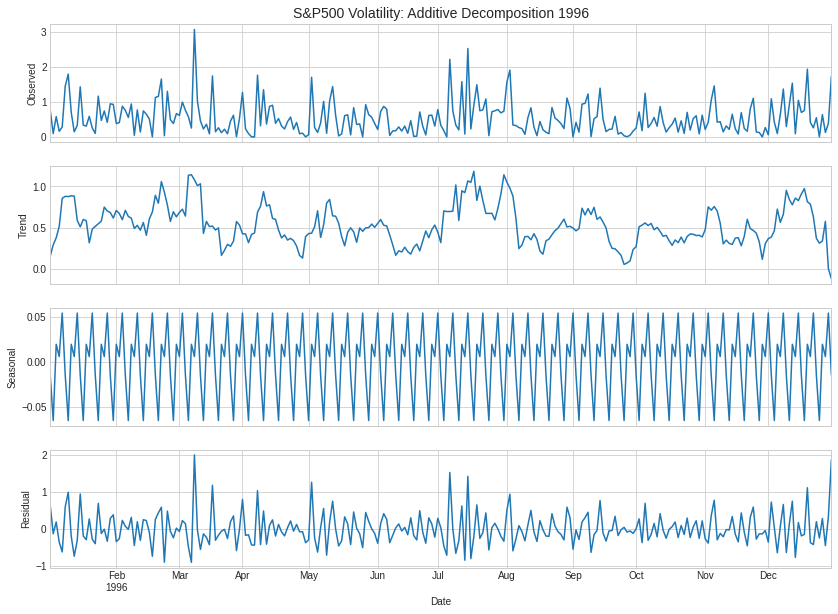

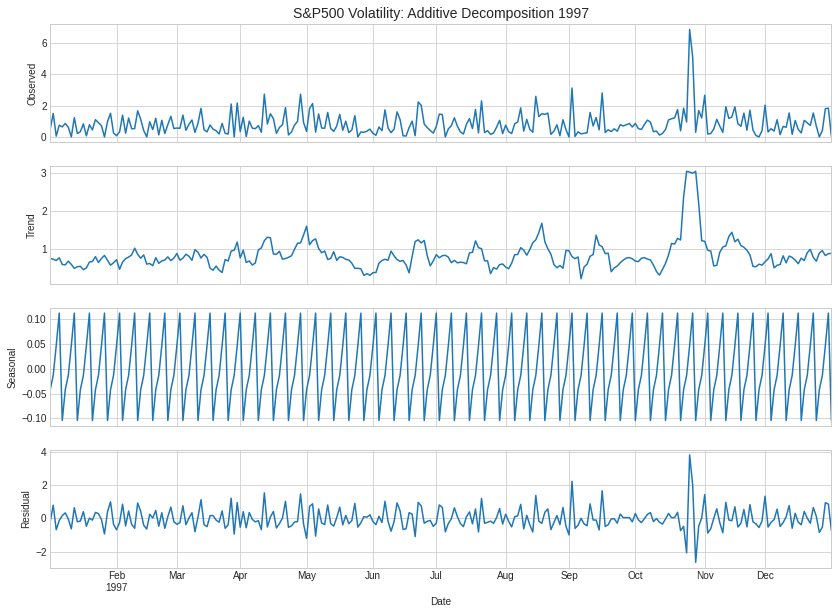

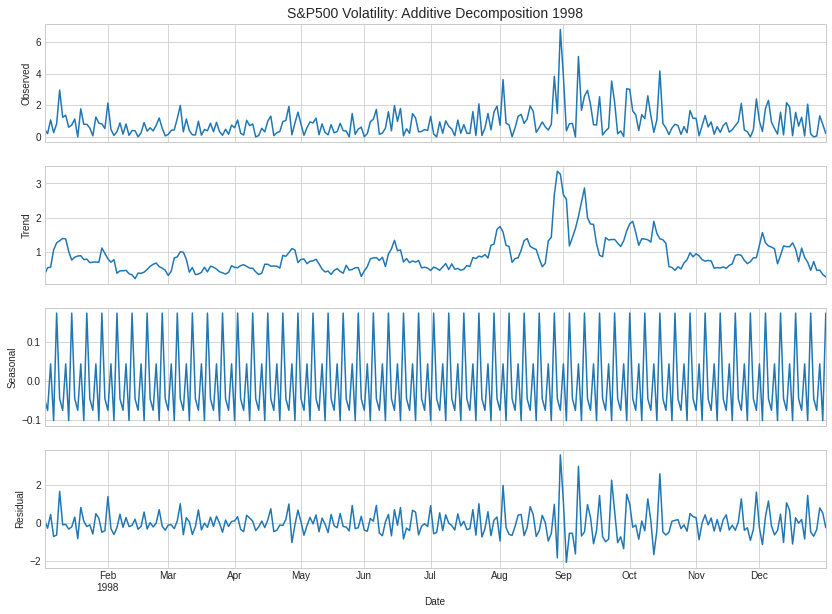

...

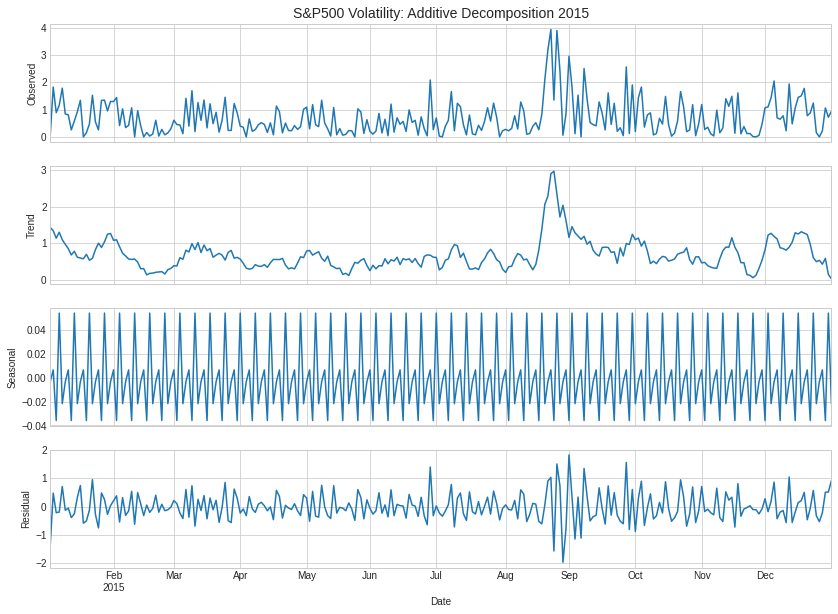

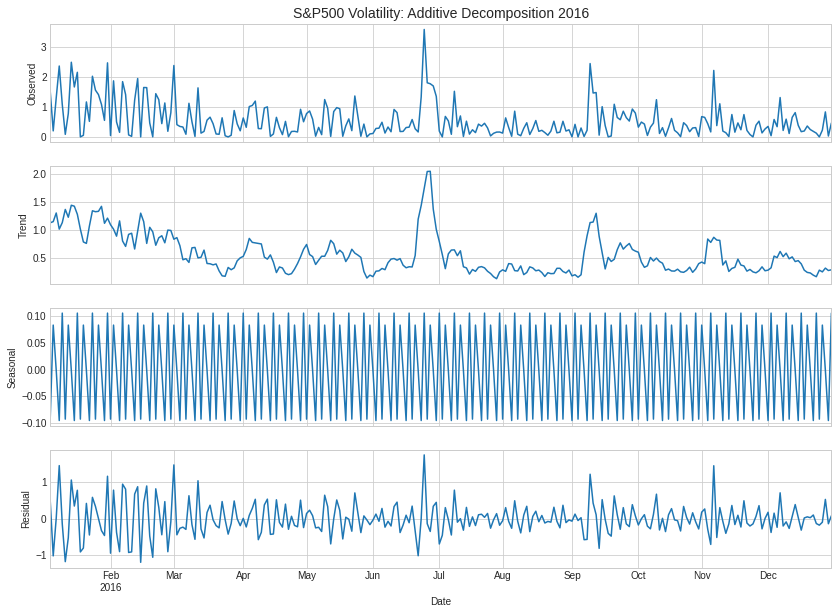

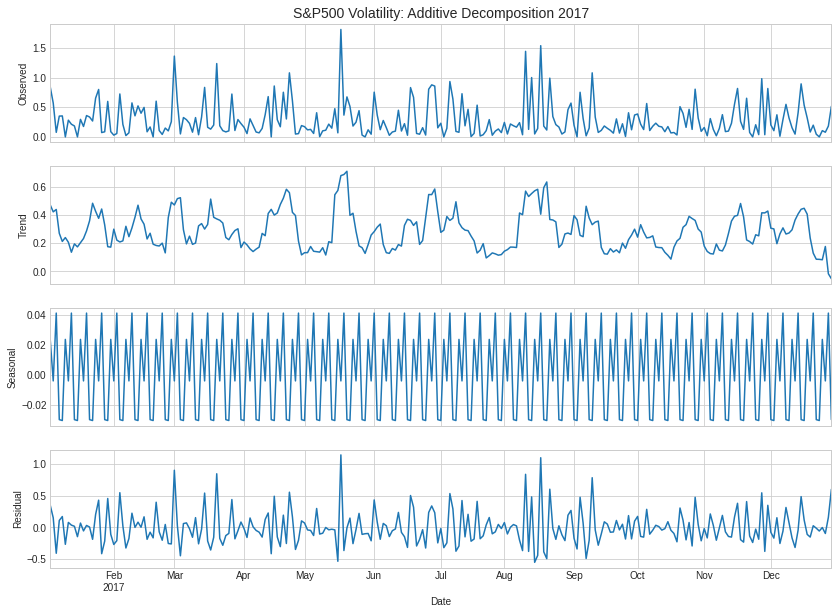

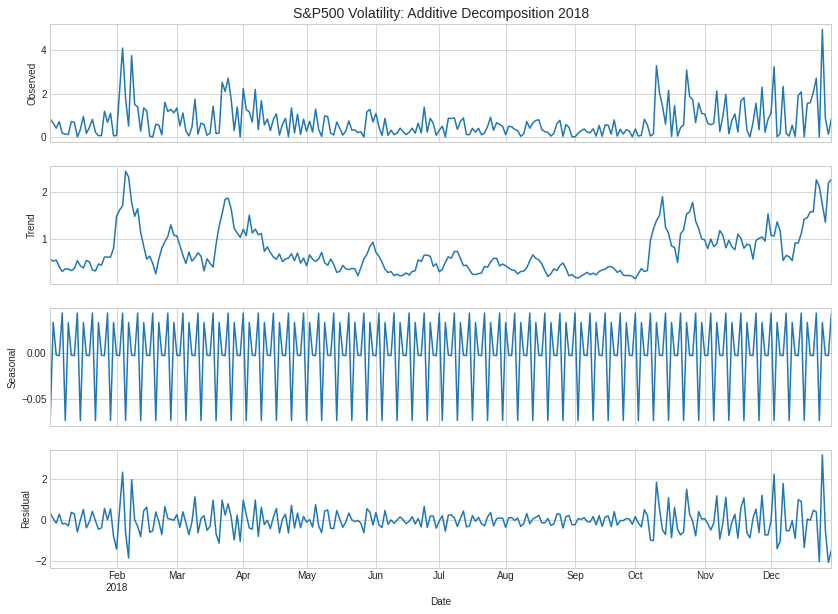

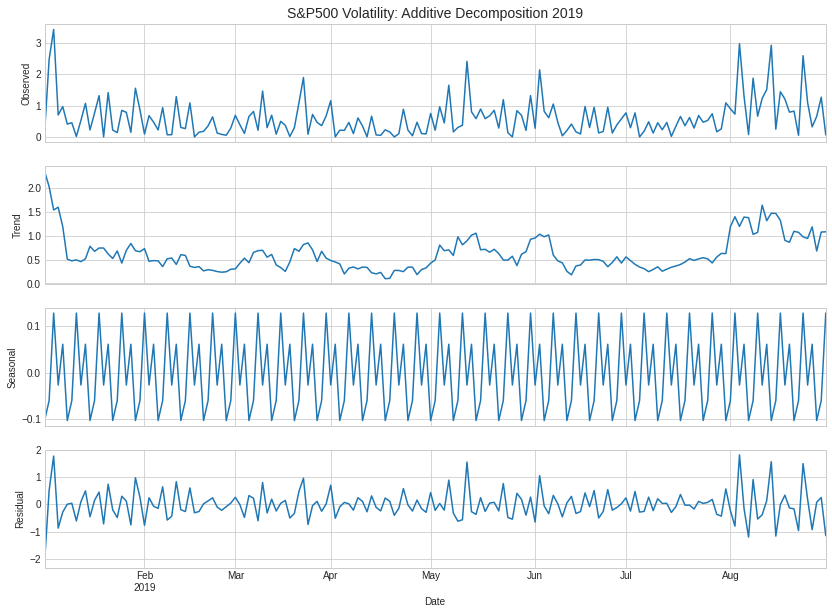

In [24]:
# plot additive decomposition of volatility by year
for year in set(sp500_df.index.year):
  addi_decomp = seasonal_decompose(sp500_df["Volatility"][sp500_df.index.year == year][1:], model="additive", extrapolate_trend="freq")
  fig, axes = plt.subplots(nrows=4, ncols=1, sharex=True, figsize=(14,10))
  plot_decomposition(addi_decomp, axes, "S&P500 Volatility: Additive Decomposition {}".format(str(year)))
  plt.show()

### Multiplicative Decomposition

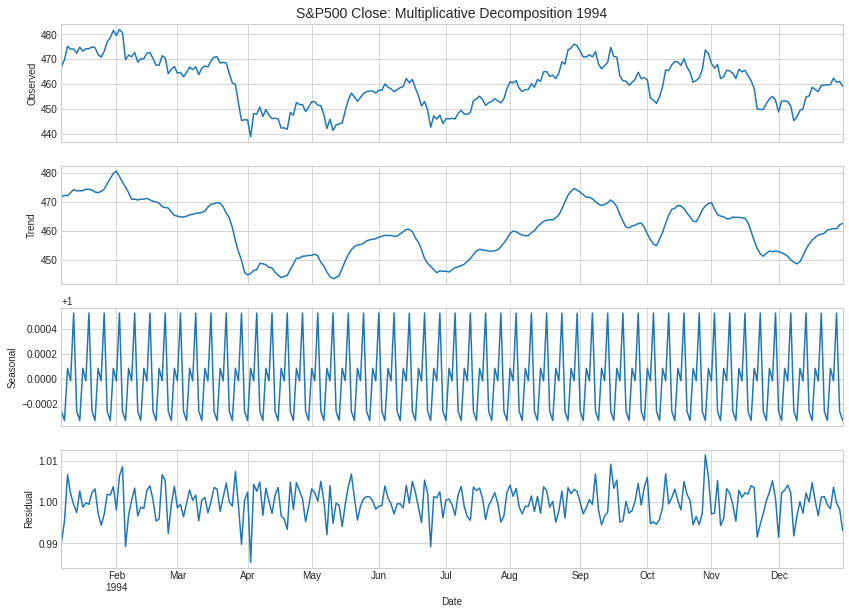

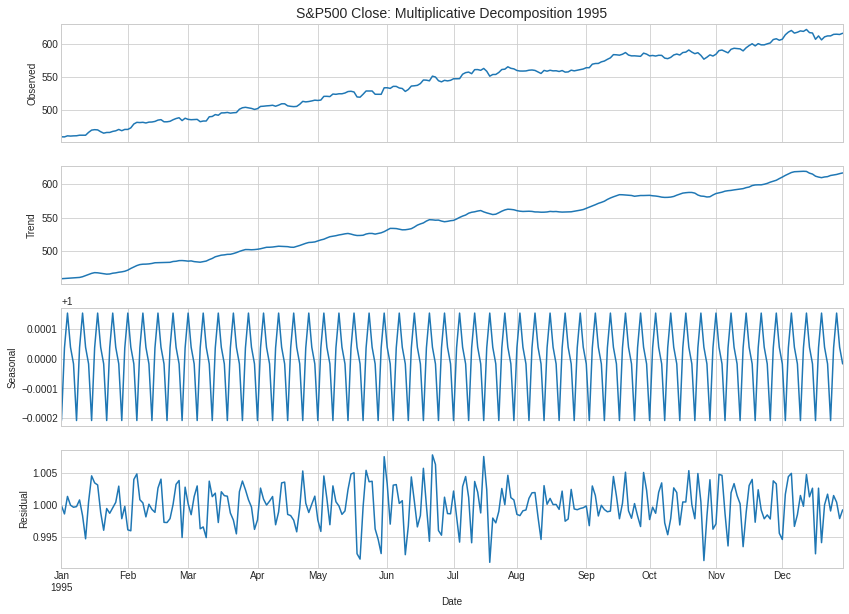

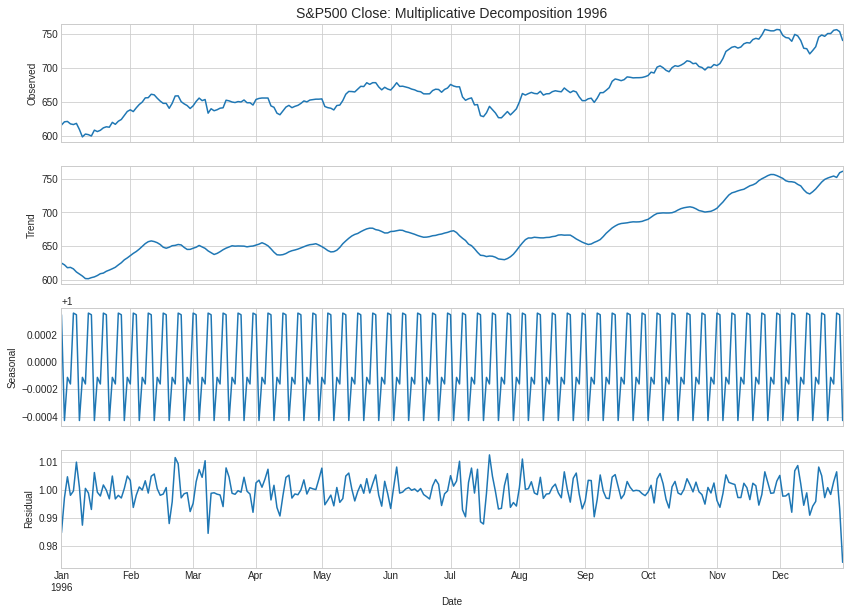

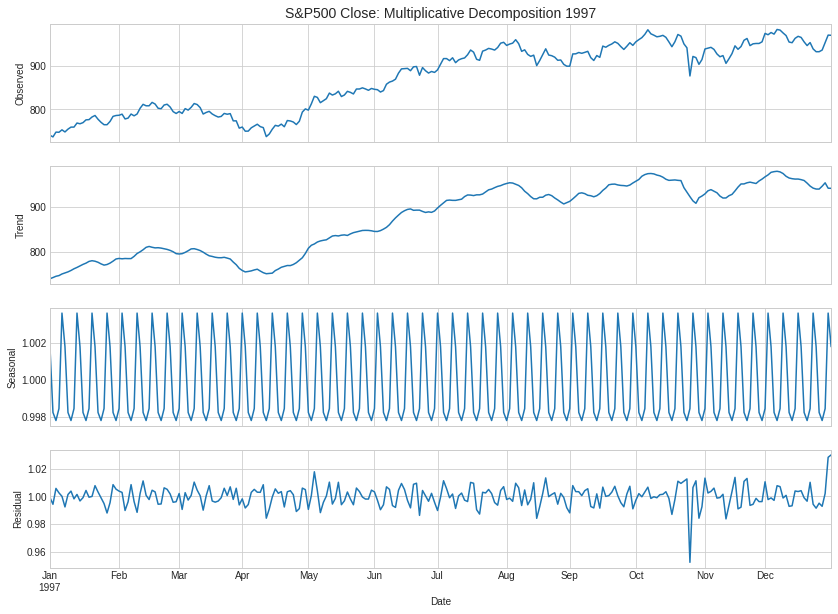

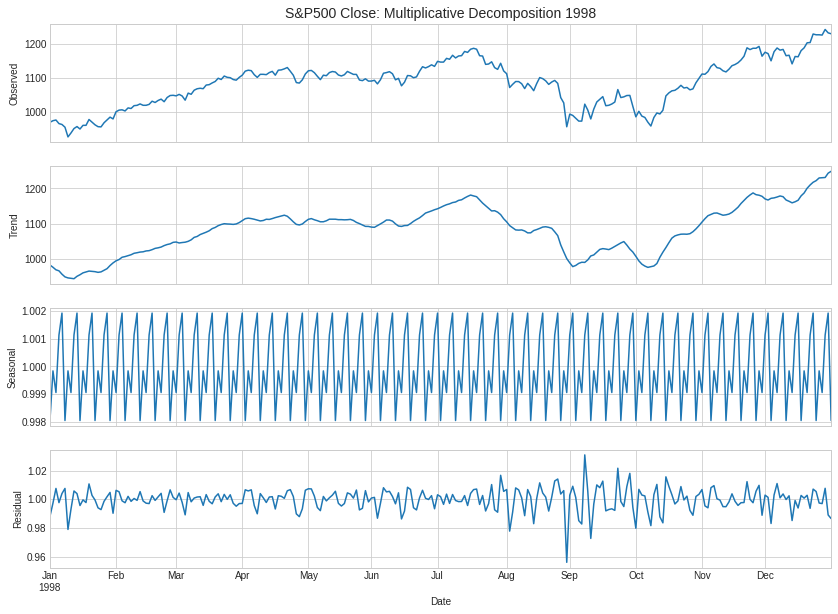

...

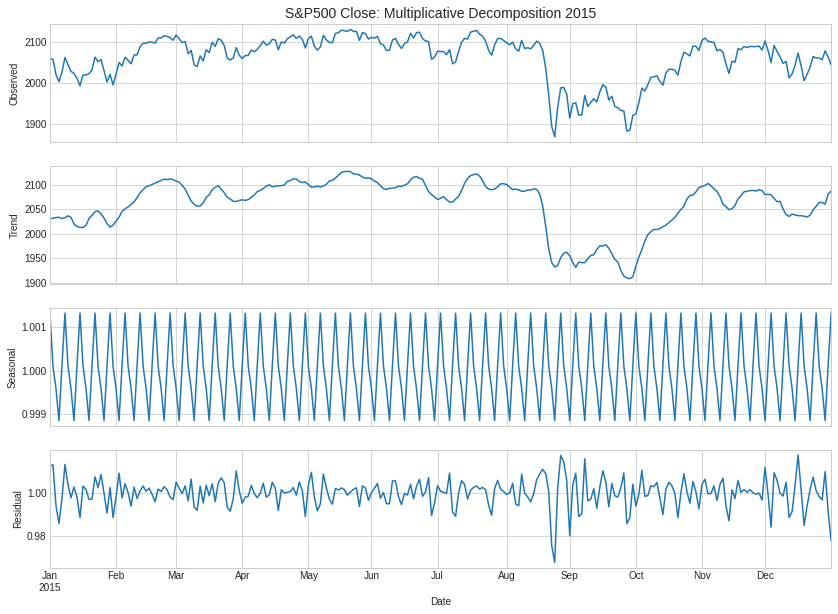

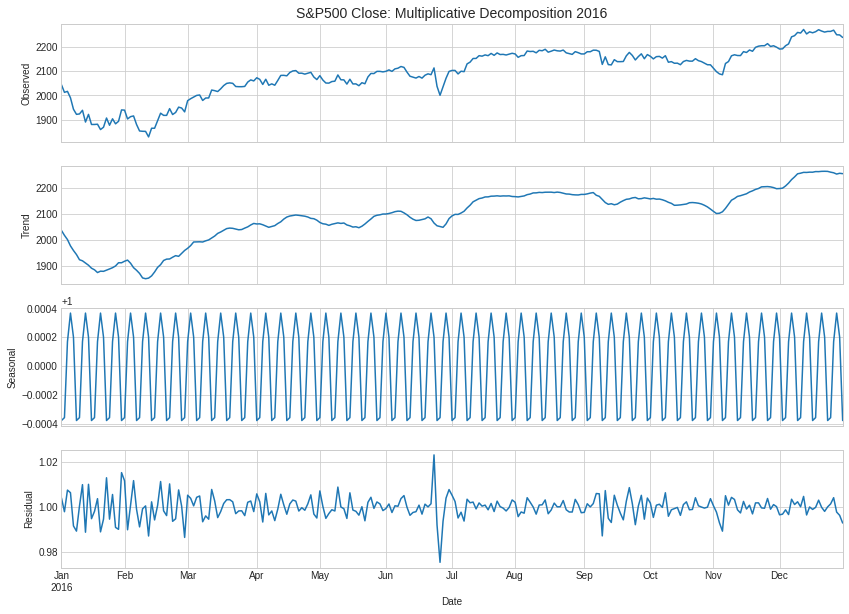

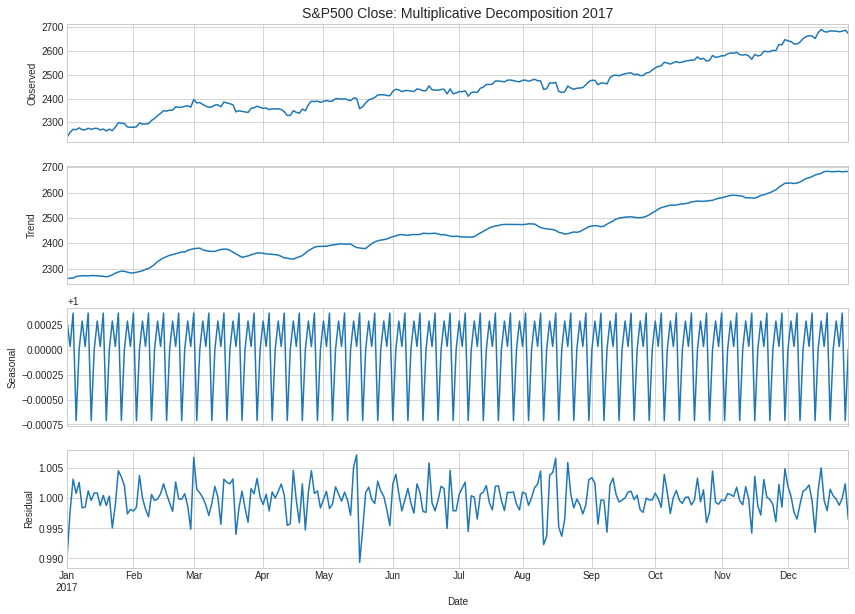

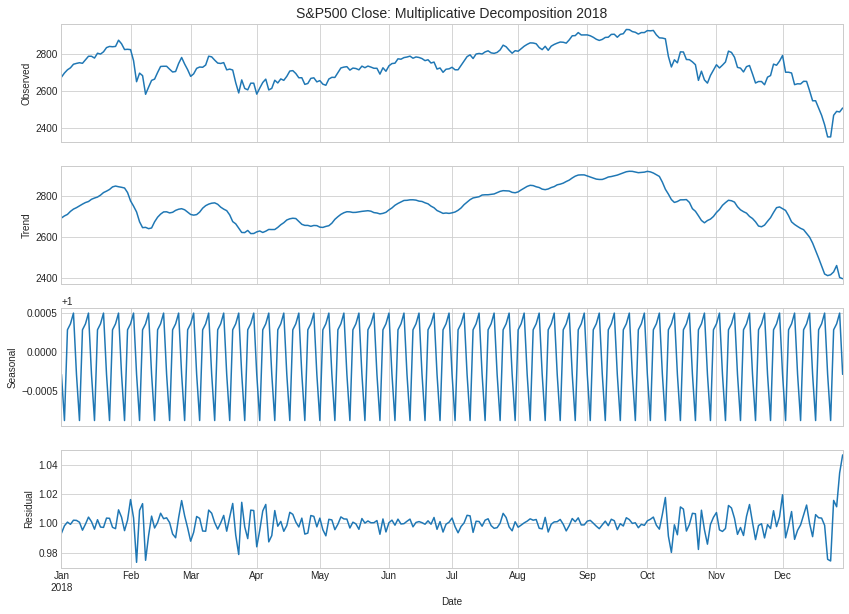

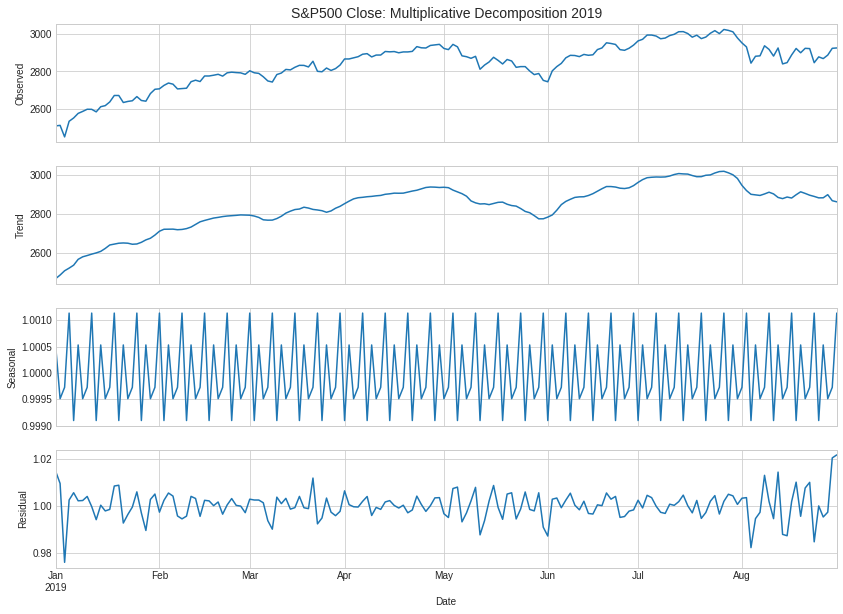

In [25]:
# plot multiplicative decomposition of close by year
for year in set(sp500_df.index.year):
  multi_decomp = seasonal_decompose(sp500_df["Close"][sp500_df.index.year == year], model="multiplicative", extrapolate_trend="freq")
  fig, axes = plt.subplots(nrows=4, ncols=1, sharex=True, figsize=(14,10))
  plot_decomposition(multi_decomp, axes, "S&P500 Close: Multiplicative Decomposition {}".format(str(year)))
  plt.show()

The plot clearly shows a repeating cycle every 5 periods. This is fairly logical as our data is stock price data. We observe and collect stock price data on every business day of the week. This means that the data was weekly seasonality, with the week being a business week (5 days a week). However on closer inspection the values are very very negligible (as seen from the scale of the y-axis). So, using a seasonality of 5 periods in our models might not produce great results.

## 1.5) Stationarity

Stationarity, in the context of time series analysis, means that the statistical properties of a series (mean, variance, etc.) remain fairly constant over time. While fitting statistical models, stationarity in a series is highly desirable. This is due to the face that, if a series is non-stationary, then its distribution will change over time. So, the distribution of data used to train models will be different than the distribution of data for which forecast needs to be generated. Therefore, the quality of forecasts will most likely be poor.

### Check summary statistics over time

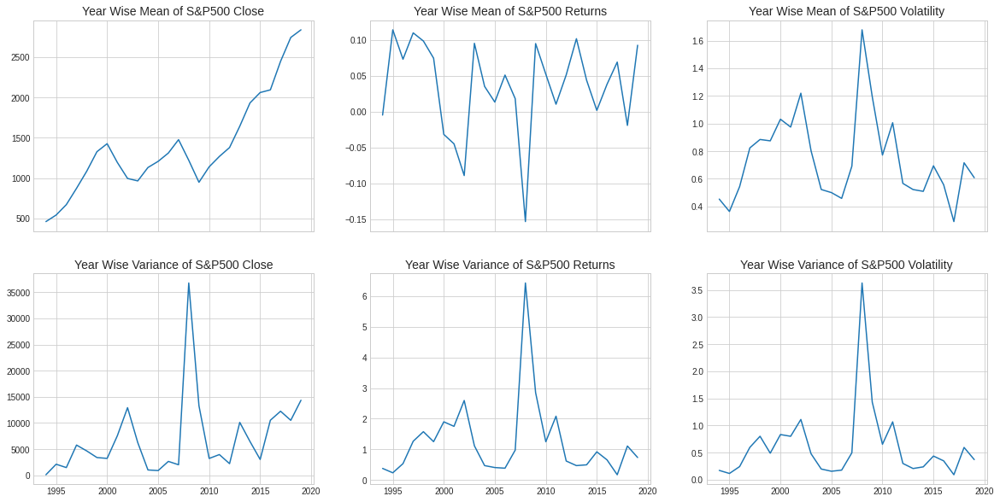

In [26]:
# Building dataframes to store yearly mean and variance
mean_df = sp500_df.groupby(by = sp500_df.index.year).mean()
var_df = sp500_df.groupby(by = sp500_df.index.year).var()

# Defining the subplots with shared x-axis
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(20,10), sharex = True)

# PLotting mean for the 3 series in the first row
ax[0, 0].plot(mean_df["Close"])
ax[0, 1].plot(mean_df["Return"])
ax[0, 2].plot(mean_df["Volatility"])

# Setting title for the first row of plots
ax[0, 0].set_title("Year Wise Mean of S&P500 Close", size = 14)
ax[0, 1].set_title("Year Wise Mean of S&P500 Returns", size = 14)
ax[0, 2].set_title("Year Wise Mean of S&P500 Volatility", size = 14)

# PLotting variance for the 3 series in the second row
ax[1, 0].plot(var_df["Close"])
ax[1, 1].plot(var_df["Return"])
ax[1, 2].plot(var_df["Volatility"])

# Setting title for the second row of plots
ax[1, 0].set_title("Year Wise Variance of S&P500 Close", size = 14)
ax[1, 1].set_title("Year Wise Variance of S&P500 Returns", size = 14)
ax[1, 2].set_title("Year Wise Variance of S&P500 Volatility", size = 14)

# Displaying the 
plt.show()

- The summary statistics of S&P500 close clearly shows major fluctuations and hence it does not seem like a stationary dataset.
- S&P500 Returns and S&P500 Volatility do seem stationary as the summary statistics are fairly constant.

### Unit Root Tests

In [27]:
# ADF (H0: non-stationary)
def adf_stationarity_test(signal):
  result_adf = adfuller(signal, autolag="AIC")
  statistic = result_adf[0]
  p_value = result_adf[1]
  used_lag = result_adf[2]
  nobs = result_adf[3]
  critical_values = result_adf[4]
  icbest = result_adf[5]
  print("________________________________")
  print(" > ADF: Is the data stationary ?")
  print(f'ADF Statistic: {statistic}')
  print(f'p-value: {p_value}')
  print(f'num lags: {used_lag}')
  print('Critial Values:')

  for key, value in critical_values.items():
      print(f'   {key}, {value}')  

  print(f'\nResult: The series is likely {"not " if p_value > 0.05 else ""}stationary')
  print("________________________________")

In [28]:
# KPSS test around constant (H0: stationary around constant)
def kpss_constant_stationarity_test(signal):
  result_kpss_c = kpss(signal, regression="c")

  statistic = result_kpss_c[0]
  p_value = result_kpss_c[1]
  n_lags = result_kpss_c[2]
  critical_values = result_kpss_c[3]

  print("________________________________")
  print(" > KPSS: Is the data stationary around a constant ?")
  print(f'KPSS Statistic: {statistic}')
  print(f'p-value: {p_value}')
  print(f'num lags: {n_lags}')
  print('Critial Values:')

  for key, value in critical_values.items():
    print(f'   {key} : {value}')
    
  print(f'\nResult: The series is likely {"not " if p_value < 0.05 else ""}stationary around a constant')
  print("________________________________")

In [29]:
# KPSS test around trend (H0: stationary around trend)
def kpss_trend_stationarity_test(signal):
  result_kpss_ct = kpss(signal, regression="ct")

  statistic = result_kpss_ct[0]
  p_value = result_kpss_ct[1]
  n_lags = result_kpss_ct[2]
  critical_values = result_kpss_ct[3]

  print("________________________________")
  print(" > KPSS: Is the data stationary around a trend ?")
  print(f'KPSS Statistic: {statistic}')
  print(f'p-value: {p_value}')
  print(f'num lags: {n_lags}')
  print('Critial Values:')

  for key, value in critical_values.items():
    print(f'   {key} : {value}')
    
  print(f'\nResult: The series is likely {"not " if p_value < 0.05 else ""}stationary around a trend')
  print("________________________________")

In [30]:
# check stationarity of S&P500 close 
print("S&P500 CLOSE STATIONARITY CHECKS:")
adf_stationarity_test(sp500_df["Close"])
kpss_constant_stationarity_test(sp500_df["Close"])
kpss_trend_stationarity_test(sp500_df["Close"])

S&P500 CLOSE STATIONARITY CHECKS:
________________________________
 > ADF: Is the data stationary ?
ADF Statistic: 0.4082240780194001
p-value: 0.9817999005880088
num lags: 6
Critial Values:
   1%, -3.4313285808185814
   5%, -2.8619724508981648
   10%, -2.5670001900066515

Result: The series is likely not stationary
________________________________
________________________________
 > KPSS: Is the data stationary around a constant ?
KPSS Statistic: 12.975573787449346
p-value: 0.01
num lags: 35
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739

Result: The series is likely not stationary around a constant
________________________________
________________________________
 > KPSS: Is the data stationary around a trend ?
KPSS Statistic: 2.4694893000238753
p-value: 0.01
num lags: 35
Critial Values:
   10% : 0.119
   5% : 0.146
   2.5% : 0.176
   1% : 0.216

Result: The series is likely not stationary around a trend
________________________________


/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:1907: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warn_msg.format(direction="smaller"), InterpolationWarning
/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:1907: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value re

In [31]:
# check stationarity of S&P500 returns 
print("S&P500 RETURNS STATIONARITY CHECKS:")
adf_stationarity_test(sp500_df["Return"][1:])
kpss_constant_stationarity_test(sp500_df["Return"][1:])
kpss_trend_stationarity_test(sp500_df["Return"][1:])

S&P500 RETURNS STATIONARITY CHECKS:
________________________________
 > ADF: Is the data stationary ?
ADF Statistic: -14.767677250435188
p-value: 2.3487898554364955e-27
num lags: 34
Critial Values:
   1%, -3.4313328461129915
   5%, -2.861974335490021
   10%, -2.567001193212927

Result: The series is likely stationary
________________________________
________________________________
 > KPSS: Is the data stationary around a constant ?
KPSS Statistic: 0.11960814650677228
p-value: 0.1
num lags: 35
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739

Result: The series is likely stationary around a constant
________________________________
________________________________
 > KPSS: Is the data stationary around a trend ?
KPSS Statistic: 0.11261095293245561
p-value: 0.1
num lags: 35
Critial Values:
   10% : 0.119
   5% : 0.146
   2.5% : 0.176
   1% : 0.216

Result: The series is likely stationary around a trend
________________________________


/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:1911: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warn_msg.format(direction="greater"), InterpolationWarning
/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:1911: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value re

In [32]:
# check stationarity of S&P500 volatility 
print("S&P500 VOLATILITY STATIONARITY CHECKS:")
adf_stationarity_test(sp500_df["Volatility"][1:])
kpss_constant_stationarity_test(sp500_df["Volatility"][1:])
kpss_trend_stationarity_test(sp500_df["Volatility"][1:])

S&P500 VOLATILITY STATIONARITY CHECKS:
________________________________
 > ADF: Is the data stationary ?
ADF Statistic: -6.585982666362661
p-value: 7.31299943143745e-09
num lags: 32
Critial Values:
   1%, -3.431332550761404
   5%, -2.861974204990981
   10%, -2.5670011237456394

Result: The series is likely stationary
________________________________
________________________________
 > KPSS: Is the data stationary around a constant ?
KPSS Statistic: 0.7287218868051457
p-value: 0.010934373926804934
num lags: 35
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739

Result: The series is likely not stationary around a constant
________________________________
________________________________
 > KPSS: Is the data stationary around a trend ?
KPSS Statistic: 0.6015273834208862
p-value: 0.01
num lags: 35
Critial Values:
   10% : 0.119
   5% : 0.146
   2.5% : 0.176
   1% : 0.216

Result: The series is likely not stationary around a trend
________________________________


/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:1907: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warn_msg.format(direction="smaller"), InterpolationWarning


**S&P500 Close Stationarity:**
- ADF: not stationary
- KPSS-C: not stationary
- KPSS-CT: not stationary

Hence, not stationary.


**S&P500 Returns Stationarity:**
- ADF:  stationary
- KPSS-C: stationary
- KPSS-CT: stationary

Hence, stationary.


**S&P500 Volatility Stationarity:**
- ADF: stationary
- KPSS-C: not stationary
- KPSS-CT: not stationary

Hence, difference stationary, i.e. use differencing to make series stationary.

# 2) Evaluation Frameworks

## 2.1) Train-Test Split

In [33]:
# all but last year as training set
train_df = sp500_df.copy().loc[:"2018-12-31",:] # first row has nans for returns and volatility
test_df = sp500_df.copy().loc["2019-01-01":,:]
train_df

,Close,Return,Volatility,Year
Date,,,,
1994-01-06,467.119995,NaN,NaN,1994
1994-01-07,469.899994,0.595136,0.595136,1994
1994-01-10,475.269989,1.142795,1.142795,1994
1994-01-11,474.130005,-0.239860,0.239860,1994
1994-01-12,474.170013,0.008438,0.008438,1994
...,...,...,...,...
2018-12-25,2351.100098,0.000000,0.000000,2018
2018-12-26,2467.699951,4.959374,4.959374,2018
2018-12-27,2488.830078,0.856268,0.856268,2018


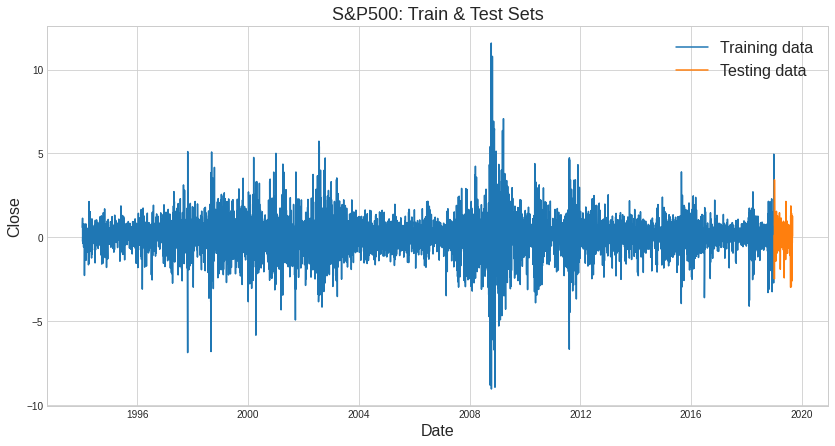

In [34]:
# visualize split on line plot 
plt.figure(figsize=(14,7))
plt.plot(train_df["Return"][1:], label="Training data")
plt.plot(test_df["Return"][1:], label="Testing data")
plt.title("S&P500: Train & Test Sets", fontsize=18)
plt.legend(fontsize=16)
plt.xlabel("Date", fontsize=16)
plt.ylabel("Close", fontsize=16)
plt.show()

## 2.2) Forecast Accuracy Metrics

In [35]:
# Accuracy metrics
def forecast_accuracy(forecast, actual):

  # Mean Absolute Percentage Error (MAPE)
  mape = np.mean(np.abs(forecast - actual)/np.abs(actual))

  # Mean (Forecast) Error (ME)
  me = np.mean(forecast - actual)       

  # Mean Absolute Error (MAE)
  mae = np.mean(np.abs(forecast - actual)) 

  # Mean Percentage Error (MPE)
  mpe = np.mean((forecast - actual)/actual) 

  # Mean Squared Error (MSE)
  mse = np.mean((forecast - actual)**2)

  # Root Mean Squared Error (RMSE)
  rmse = np.mean((forecast - actual)**2)**.5

  # Correlation between the Actual and the Forecast (corr)
  corr = np.corrcoef(forecast, actual)[0,1] 

  # Lag 1 Autocorrelation of Error (ACF1)
  acf1 = acf(forecast-actual)[1]       

  # Min-Max Error (minmax)
  mins = np.amin(np.hstack([forecast[:,None], 
                            actual[:,None]]), axis=1)
  maxs = np.amax(np.hstack([forecast[:,None], 
                            actual[:,None]]), axis=1)
  minmax = 1 - np.mean(mins/maxs)      
  
  # output
  return pd.Series({'mape':mape,
                    'me':me, 
                    'mae': mae, 
                    'mpe': mpe, 
                    'mse': mse,
                    'rmse':rmse, 
                    'acf1':acf1, 
                    'corr':corr, 
                    'minmax':minmax})

## 2.3) Naive Forecast (Baseline Model)

The most common baseline method for time series forecasting is the Naive forecast, this is simply the latest value of the series that is available at the time of prediction. The naive algorithm uses the value at the current time step (t) to predict the expected outcome at the next time step (t+1).

### Lag features

In [36]:
# create lag features
naive_df = pd.DataFrame({"r(t)":sp500_df["Return"], "r(t+1)":sp500_df["Return"].shift(-1)})
naive_df

,r(t),r(t+1)
Date,,
1994-01-06,NaN,0.595136
1994-01-07,0.595136,1.142795
1994-01-10,1.142795,-0.239860
1994-01-11,-0.239860,0.008438
1994-01-12,0.008438,-0.358524
...,...,...
2019-08-26,1.098299,-0.320318
2019-08-27,-0.320318,0.654548
2019-08-28,0.654548,1.268729


### Train-Test Split

In [37]:
# create naive train-test split
naive_train_df = naive_df.copy().loc[:"2018-12-31",:].iloc[1:] # first row has nans for returns and volatility
naive_test_df = naive_df.copy().loc["2019-01-01":,:].iloc[:-1]

naive_train_X = naive_train_df.loc[:, "r(t)"]
naive_train_y = naive_test_df.loc[:, "r(t+1)"]

naive_test_X = naive_test_df.loc[:, "r(t)"]
naive_test_y = naive_test_df.loc[:, "r(t+1)"]

### Forecast Model

In [38]:
# develop naive forecast
def model_persistence(x):
  return x

### Predict & evaluate forecast

In [39]:
# walk-forward validation
naive_pred = list()
for x in naive_test_X:
  yhat = model_persistence(x)
  naive_pred.append(yhat)
naive_pred = pd.Series(np.array(naive_pred))
naive_pred.index = naive_test_y.index

# Accuracy metrics
forecast_accuracy(naive_pred, naive_test_y)

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:662: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:671: FutureWarning: fft=True will become the default after the release of the 0.12 release of statsmodels. To suppress this warning, explicitly set fft=False.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before 

mape           inf
me       -0.000372
mae       0.905434
mpe            inf
mse       1.612442
rmse      1.269820
acf1     -0.534382
corr     -0.099036
minmax         inf
dtype: float64

### Plot Naive Forecast

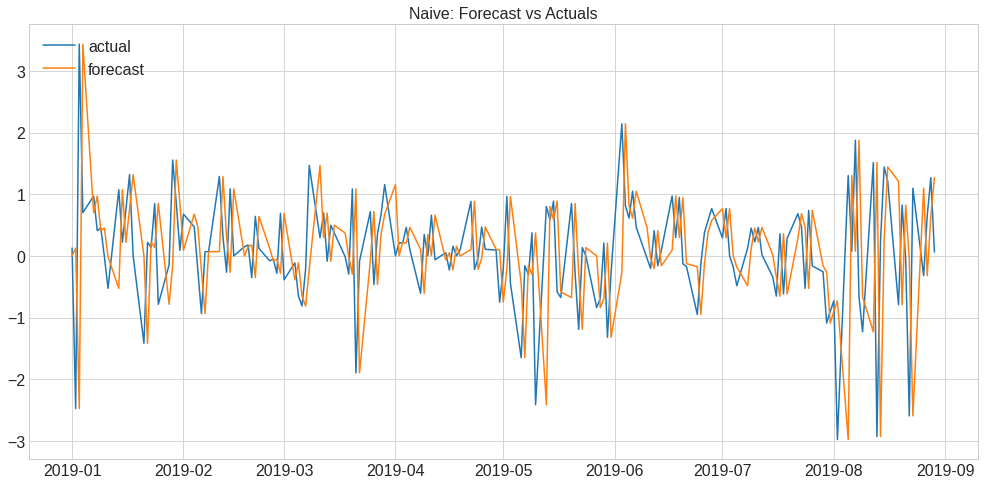

In [40]:
# Plot
plt.figure(figsize=(17,8))

#plt.plot(naive_train_y.iloc[-252:], label='training')
plt.plot(naive_test_y, label='actual')
plt.plot(naive_pred, label='forecast')

plt.title('Naive: Forecast vs Actuals', fontsize=16)
plt.legend(loc='upper left', fontsize=16)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)

plt.show()

Looking at the line plot we can see a decent prediction on the test dataset. We have to maintain or improve this accuracy when we explore other advanced techniques.

### Residuals of Naive Forecast

In [41]:
# calculate forecast error (naive residual)
naive_residuals = pd.DataFrame({"Residuals":naive_test_y - naive_pred})
naive_residuals.head()

,Residuals
Date,
2019-01-01,0.126850
2019-01-02,-2.602523
2019-01-03,5.909245
2019-01-04,-2.732528
2019-01-07,0.268485


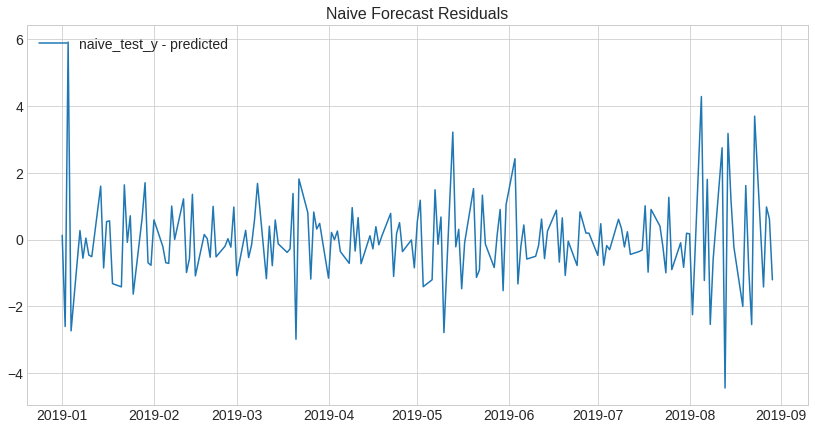

In [42]:
# Plot residuals as line plot
plt.figure(figsize=(14,7))
plt.plot(naive_residuals, label='naive_test_y - predicted')
plt.title('Naive Forecast Residuals', fontsize=16)
plt.legend(loc='upper left', fontsize=14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.show()

In [43]:
# residual summary statistics
print(naive_residuals.describe())

        Residuals
count  173.000000
mean     0.000372
std      1.273506
min     -4.442444
25%     -0.713270
50%     -0.091204
75%      0.613496
max      5.909245


<Figure size 1008x504 with 0 Axes>

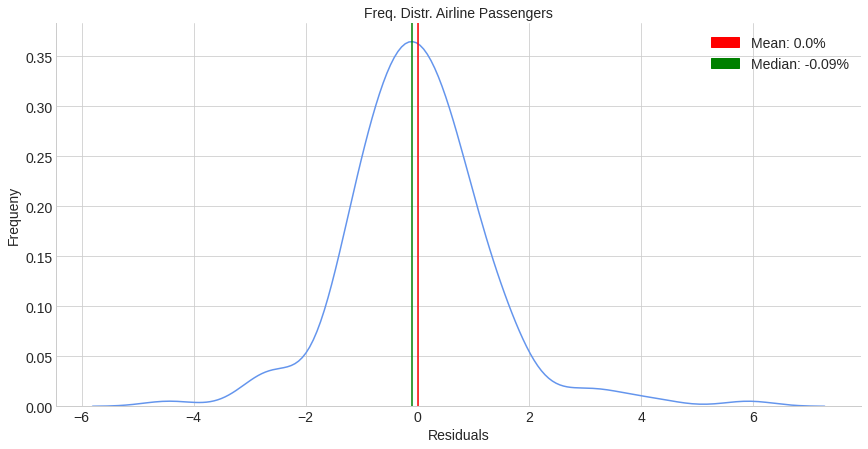

In [44]:
# plot naive residuals kde
plt.figure(figsize=(14,7))

sns.displot(naive_residuals, 
            x="Residuals", 
            kind="kde", 
            color="cornflowerblue",
            height=6,
            aspect=12/6)

mean = naive_residuals["Residuals"].mean()
median = naive_residuals["Residuals"].median()
plt.axvline(x=mean, c="r")
plt.axvline(x=median, c="g")
mean_patch = mpatches.Patch(color="r", label="Mean: {}%".format(np.around(mean,2)))
median_patch = mpatches.Patch(color="g", label="Median: {}%".format(np.around(median,2)))

plt.legend(handles=[mean_patch, median_patch], fontsize=14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel("Residuals", fontsize=14)
plt.ylabel("Frequeny", fontsize=14)
plt.title("Freq. Distr. Airline Passengers", fontsize=14)

plt.show()

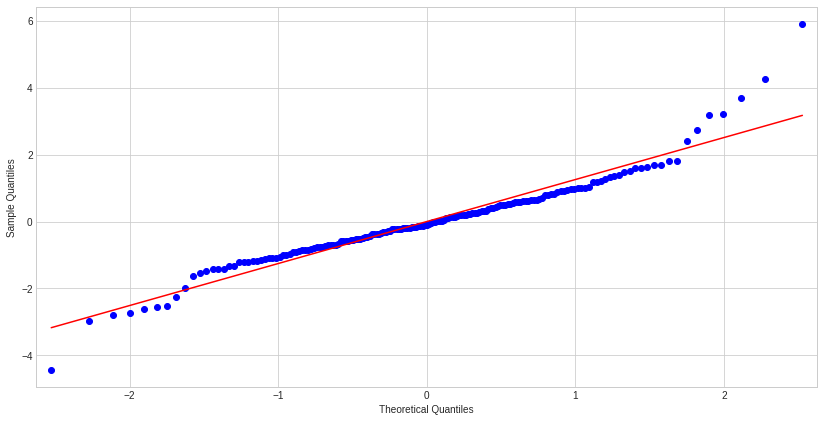

In [45]:
# Draw Q-Q plot of naive residuals
fig, axis = plt.subplots(1,1, figsize=(14,7))
qqplot(np.array(naive_residuals["Residuals"]), line="r", ax=axis)
plt.show()

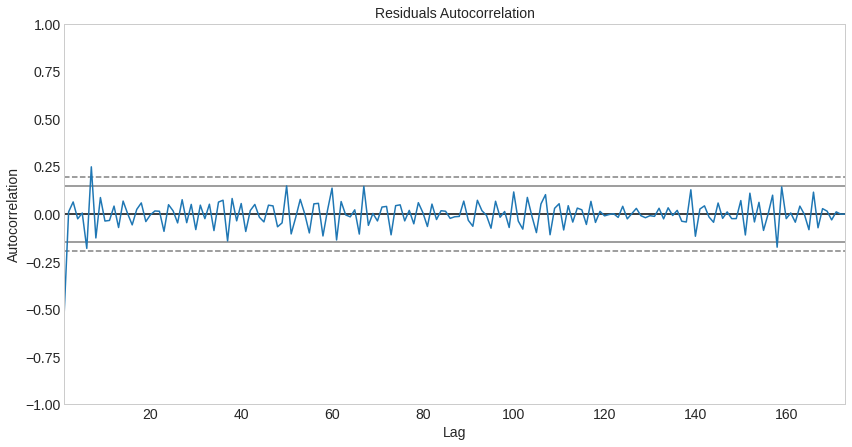

In [46]:
# plot autocorrelation of naive residuals
plt.figure(figsize=(14,7))
autocorrelation_plot(naive_residuals["Residuals"])
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel("Lag", fontsize=14)
plt.ylabel("Autocorrelation", fontsize=14)
plt.title("Residuals Autocorrelation", fontsize=14)
plt.show()

# 3) Univariate Forecasting (ARIMA & SARIMA Model)

The confidence intervals generated were constant and did not offer any significant insight on our model’s predictions. It is clear that there are regions where the model had reasonably accurate predictions and there were regions where the predictions were off by a bigger margin. The confidence intervals should reflect these changes in prediction accuracy. To do this, we will use a GARCH model on top of the ARIMA model.

## 3.1) Estimate initial parameters

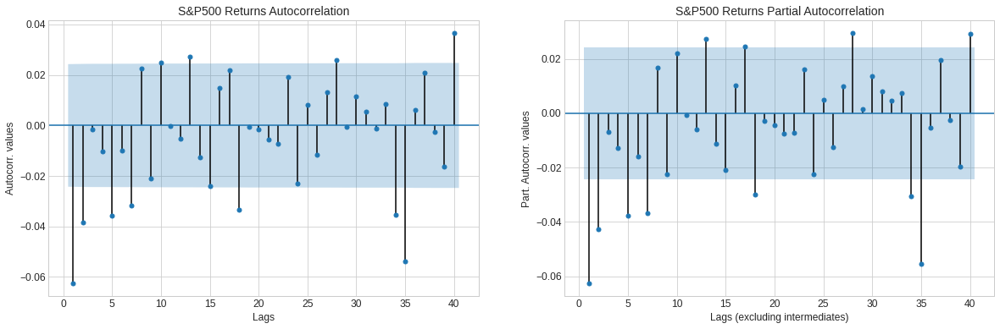

In [47]:
# autocorrelation & partial autocorrelation for last 40 days
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20, 6))

# close autocorrelation
plot_acf(train_df["Return"][1:].tolist(), zero=False, lags=40, ax=axes[0])
axes[0].set_title("S&P500 Returns Autocorrelation", fontsize=14)
axes[0].set_xlabel('Lags', fontsize=12)
axes[0].set_ylabel('Autocorr. values', fontsize=12)
plt.setp(axes[0].get_xticklabels(), fontsize=12)
plt.setp(axes[0].get_yticklabels(), fontsize=12)
# close partial autocorrelation
plot_pacf(train_df["Return"][1:].tolist(), zero=False, lags=40, ax=axes[1])
axes[1].set_title("S&P500 Returns Partial Autocorrelation", fontsize=14)
axes[1].set_xlabel('Lags (excluding intermediates)', fontsize=12)
axes[1].set_ylabel('Part. Autocorr. values', fontsize=12)
plt.setp(axes[1].get_xticklabels(), fontsize=12)
plt.setp(axes[1].get_yticklabels(), fontsize=12)

plt.show()

Based on these plots and the EDA done previously:

- The S&P500 Returns are stationary, so no need for differencing (seasonal or otherwise). So, $d = 0$ and/or $D = 0$
- The ACF and PACF plot clearly indicate that the data the first 2 lags are significant. So $p = 1$ or $p = 2$ could work for AR model. Similarly, $q = 1$ or $q = 2$ could work for the MA model.
- Lastly, the 5th lag is significant in both the plots. We know from EDA that we are dealing with financial data and hence some similar patterns are expected on a weekly basis (which consists of 5 days - business days). Thus, if seasonal models are used, then $P = 1$, $Q = 1$ and $M = 5$ are resonable guesses for the model parameters.

## 3.2) Model Building Function


The following function is used to build SARIMA Models, print the model summary (optional), plot the predictions over some period (optional) and plot the ACF and PACF plots of residuals (optional).

In [48]:
def fit_seasonal_model(train_data, params, seasonal_params, 
                      verbose = False, plot_pred = False, plot_resid = False, 
                      start_date = "2019-01-01", end_date = "2019-12-31"):
    
    model = SARIMAX(train_data, order=params, seasonal_order=seasonal_params)
    model_results = model.fit()
    
    if verbose == True:
        print(model_results.summary())
    
    if plot_pred == True:
        # get prediction
        pred = model_results.predict(start=start_date, end=end_date)
        # plot prediction against actuals
        plt.figure(figsize=(20,6))
        plt.plot(sp500_df["Return"][start_date:end_date], label='actual')
        plt.plot(pred, label='forecast')
        plt.title('Model Forecast vs Actuals', fontsize=16)
        plt.legend(loc='upper left', fontsize=16)
        plt.xticks(fontsize=16)
        plt.yticks(fontsize=16)
        plt.show()
    
    if plot_resid == True:
        # plot ACF & PACF of residuals
        fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20, 6))
        # close autocorrelation
        plot_acf(model_results.resid[1:], zero=False, lags=40, ax=axes[0])
        axes[0].set_title("Residuals Autocorrelation", fontsize=14)
        axes[0].set_xlabel('Lags', fontsize=12)
        axes[0].set_ylabel('Autocorr. values', fontsize=12)
        plt.setp(axes[0].get_xticklabels(), fontsize=12)
        plt.setp(axes[0].get_yticklabels(), fontsize=12)
        # close partial autocorrelation
        plot_pacf(model_results.resid[1:], zero=False, lags=40, ax=axes[1])
        axes[1].set_title("Residuals Partial Autocorrelation", fontsize=14)
        axes[1].set_xlabel('Lags (excluding intermediates)', fontsize=12)
        axes[1].set_ylabel('Part. Autocorr. values', fontsize=12)
        plt.setp(axes[1].get_xticklabels(), fontsize=12)
        plt.setp(axes[1].get_yticklabels(), fontsize=12)
        plt.show()
    
    return model_results

## 3.3) Non-Seasonal Model (p, d, q) = (1, 0, 1)

The non seasonal SARIMA model: ARIMA is an acronym for Auto-Regressive Integrated Moving Average Model. This model is a collection of 3 components:

- AR (Auto-Regressive Component): This component of the ARIMA model is used to capture the dependence of current observation with past observations. The parameter of ARIMA models that control this component is denoted as p.
- I (Integrated): This component of the ARIMA model is used to denote the number of times the series needs to be differenced with lagged versions of itself. Ideally this operation of differencing should be carried out till the series is stationary. The parameter of ARIMA models that control this component is denoted as d.
- MA (Moving Average): This component of the ARIMA model is used to capture the effect of past residuals on the value of the current observation. The parameter of ARIMA models that control this component is denoted as q.

An ARIMA models is usually specified as follows: ARIMA(p, d, q). The parameters p, d, and q represent the AR, I and MA components of the model as described above. The following rules are general guidelines that are commonly followed while choosing initial parameters for the ARIMA models.

- p (AR Component): The number of significant lags in the PACF plot of the series is a good stating point for AR component.
- d (I Component): If the series is not stationary and needs to be differenced a certain number of times to remove trend and stationarity, then the number of times this operation is done becomes the order of the Integrated Component.
- q (MA Component): The number of significant lags in the ACF plot of the series is a good stating point for AR component.



                               SARIMAX Results                                
Dep. Variable:                 Return   No. Observations:                 6517
Model:               SARIMAX(1, 0, 1)   Log Likelihood              -10024.948
Date:                Mon, 23 Aug 2021   AIC                          20055.897
Time:                        18:02:37   BIC                          20076.243
Sample:                    01-07-1994   HQIC                         20062.933
                         - 12-31-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6462      0.047     13.689      0.000       0.554       0.739
ma.L1         -0.7075      0.043    -16.560      0.000      -0.791      -0.624
sigma2         1.2696      0.010    128.105      0.0

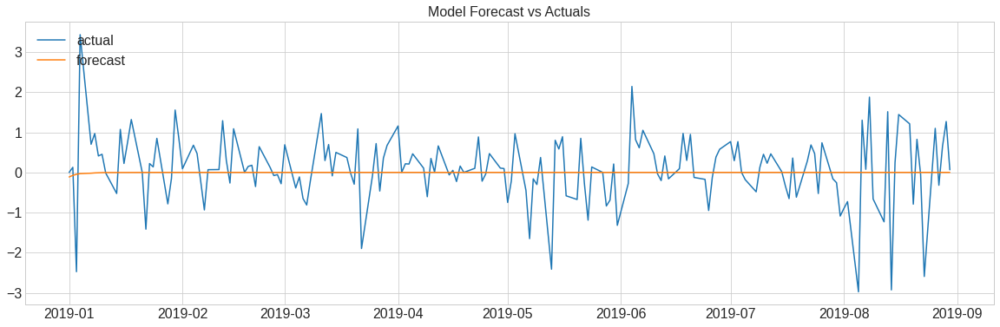

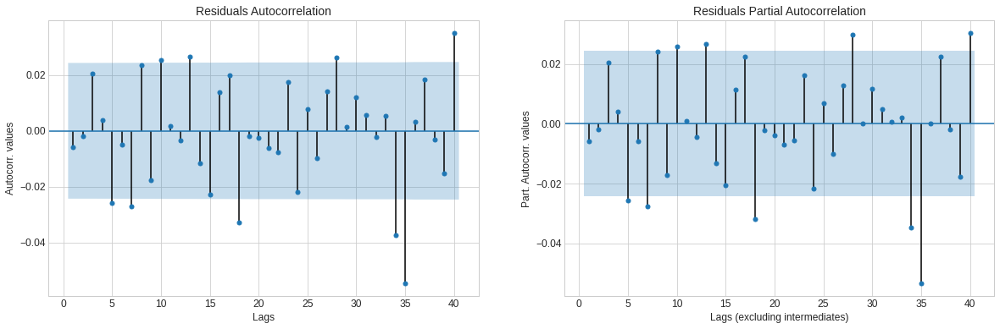

In [49]:
# fit non-seasonal model
model_results = fit_seasonal_model(train_df["Return"][1:], (1, 0, 1), (0, 0, 0, 0), 
                                   verbose = True, plot_pred = True, plot_resid = True, 
                                   start_date = test_df.index[0], end_date = test_df.index[-1])

## 3.4) Seasonal Model (p=1, d=0, q=1) & (P=1, D=0, Q=1, M=5)

The ARIMA model explored above cannot effectively capture the seasonal patterns in the series. For this, we use the SARIMA class of models. SARIMA stands for Seasonal Auto-Regressive Integrated Moving Average model. A SARIMA models is specified as follows: SARIMA(p, d, q)(P, D, Q, m)

Non-Seasonal Parameters:

- p (AR component): Same as the AR component in ARIMA.
- d (I component): Same as the I component in ARIMA. Denotes the number of times successive differencing operation is performed to make the series stationary.
- q (MA component): Same as the MA component in ARIMA.

Seasonal Parameters:

- m (Seasonal Period): This denotes the number of periods in the series after which a seasonal pattern is repeated. It is common to see this parameter also denoted by the letter s.
- P (Seasonal AR component): This parameter captures the effect of past lags on current observations. Unlike p, the past lags are separated from the current lag by multiples of m lags. For eg, if m=12, and P=2, then the current observation is estimated using observations from the 12th lag and 24th lag.
- D (Seasonal I component): This is the number of times seasonal differences need to be calculated in order to make the series stationary. Unlike d, where the differencing was done with successive observations (1st lagged series), here the differencing is done between the series and mth lagged series.
- Q (Seasonal MA Component): This parameter captures the effect of past residuals on current observations. Unlike q, the past lags are separated from the current lag by multiples of m lags. For eg, if m=12, and Q=2, then the current observation is estimated using residuals from the 12th lag and 24th lag.

The parameters of the SARIMA(p, d, q)(P, D, Q, m) are estimated using the following general guidelines:

- p: Plot the PACF plot for the series and count the number of significant lags.
- d: The number of successive differencing operations needed to convert the series to stationary.
- q: Plot the ACF plot for the series and count the number of significant lags.
- m: The number of lags after which some seasonal pattern is observed.
- P: Plot the PACF plot again, and observe the number of significant lags separated by multiples of m.
- D: The number of seasonal differences needed to convert the series to stationary.
- Q: Plot the ACF plot again, and observe the number of significant lags separated by multiples of m.

Parameter Estimation:

- p = 1, or p = 2 : First 2 lags of PACF are significant.
- d = 0 : No successive differencing was performed in the S&P 500 Returns series.
- q = 1, or q = 2 : First 2 lags of ACF are significant.
- m = 5 : The observations are observed on business days (5 days a week) and there was presence of a seasonal pattern in the decomposition of the series done in part 2 of this series.
- P = 1 : 5th lag is significant in PACF plot.
- D = 0 : There was no seasonal differencing performed here.
- Q = 1, or Q = 2 : 5th and 10th lags are significant in ACF plot.

                                     SARIMAX Results                                     
Dep. Variable:                            Return   No. Observations:                 6517
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 5)   Log Likelihood              -10019.228
Date:                           Mon, 23 Aug 2021   AIC                          20048.456
Time:                                   18:02:42   BIC                          20082.366
Sample:                               01-07-1994   HQIC                         20060.183
                                    - 12-31-2018                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5426      0.062      8.815      0.000       0.422       0.663
ma.L1         -0.6075      0.057    -10.647

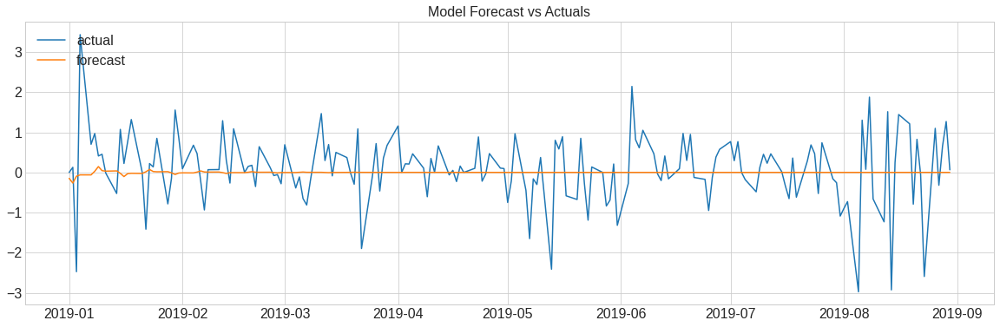

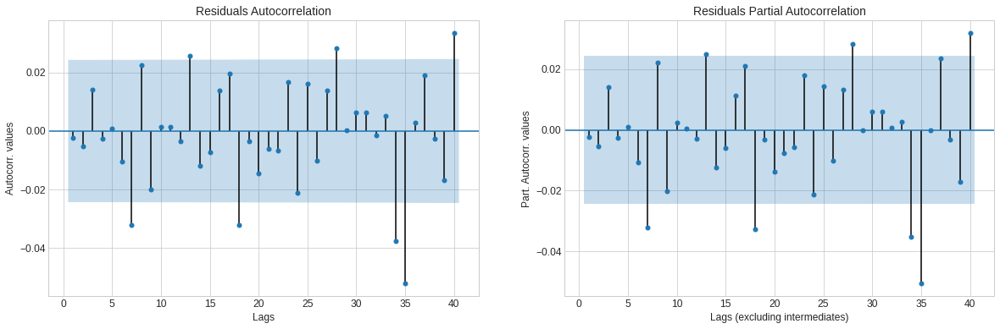

In [50]:
seasonal_model_results = fit_seasonal_model(train_df["Return"][1:], (1, 0, 1), (1, 0, 1, 5), 
                                            verbose = True, plot_pred = True, plot_resid = True, 
                                            start_date = test_df.index[0], end_date = test_df.index[-1])

In [51]:
accuracy_table = pd.DataFrame({"Accuracy":["mape", "me", "mae", "mpe", "mse", "rmse", "acf1", "corr", "minmax"]})
accuracy_table.set_index(["Accuracy"], inplace=True)
accuracy_table["Naive"] = forecast_accuracy(naive_pred, naive_test_y)
non_seasonal_pred = model_results.predict(test_df.index[0], test_df.index[-1])
accuracy_table["Non-Seasonal"] = forecast_accuracy(non_seasonal_pred, test_df["Return"])
seasonal_pred = seasonal_model_results.predict(test_df.index[0], test_df.index[-1])
accuracy_table["Seasonal"] = forecast_accuracy(seasonal_pred, test_df["Return"])
accuracy_table

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:662: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:671: FutureWarning: fft=True will become the default after the release of the 0.12 release of statsmodels. To suppress this warning, explicitly set fft=False.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before 

,Naive,Non-Seasonal,Seasonal
Accuracy,,,
mape,inf,inf,inf
me,-0.000372,-0.094492,-0.095340
mae,0.905434,0.608680,0.610583
mpe,inf,-inf,NaN
mse,1.612442,0.738445,0.741420
rmse,1.269820,0.859328,0.861057
acf1,-0.534382,-0.098763,-0.098094
corr,-0.099036,-0.000491,-0.038976
minmax,inf,inf,inf


## 3.5) Final SARIMA Model (p=1, d=0, q=1)

The RMSE is calculated over predictions in the test set. On the other hand, the AIC is calculated over the train set. Thus if the priority is to model the train set well, then the model with lower AIC should be preferred, and if the model should perform well on the test set, then RMSE will have greater importance.

In [52]:
# define and fit model
final_model = SARIMAX(train_df["Return"][1:], order = (1, 0, 1))
final_model_results = final_model.fit()
print(final_model_results.summary())

                               SARIMAX Results                                
Dep. Variable:                 Return   No. Observations:                 6517
Model:               SARIMAX(1, 0, 1)   Log Likelihood              -10024.948
Date:                Mon, 23 Aug 2021   AIC                          20055.897
Time:                        18:02:44   BIC                          20076.243
Sample:                    01-07-1994   HQIC                         20062.933
                         - 12-31-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6462      0.047     13.689      0.000       0.554       0.739
ma.L1         -0.7075      0.043    -16.560      0.000      -0.791      -0.624
sigma2         1.2696      0.010    128.105      0.0

## 3.6) Confidence Intervals

Confidence Intervals give an idea about the margin of error that could be associated with the predictions. They offer unique insights about when, and to what extent are the predictions stable. That is why they are important while making business decisions based on the forecasts. Alpha = 0.05 indicates that we have 95% confidence in observing the predictions between the intervals.

In [53]:
# set prediction interval
start_date = test_df.index[0]
end_date = test_df.index[-1]

In [54]:
# predictions
final_forecast = final_model_results.get_forecast(len(test_df.index))
final_predictions_df = final_forecast.conf_int(alpha = 0.05) # Confidence level of 95%
final_predictions_df["Predictions"] = final_model_results.predict(start = start_date, end = end_date)
final_predictions_df

,lower Return,upper Return,Predictions
2019-01-01,-2.322299,2.094458,-1.139207e-01
2019-01-02,-2.286135,2.138912,-7.361190e-02
2019-01-03,-2.261818,2.166686,-4.756566e-02
2019-01-04,-2.245709,2.184238,-3.073541e-02
2019-01-07,-2.235135,2.195414,-1.986024e-02
...,...,...,...
2019-08-26,-2.215490,2.215490,-1.011568e-33
2019-08-27,-2.215490,2.215490,-6.536430e-34
2019-08-28,-2.215490,2.215490,-4.223632e-34
2019-08-29,-2.215490,2.215490,-2.729177e-34


/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:662: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:671: FutureWarning: fft=True will become the default after the release of the 0.12 release of statsmodels. To suppress this warning, explicitly set fft=False.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before 

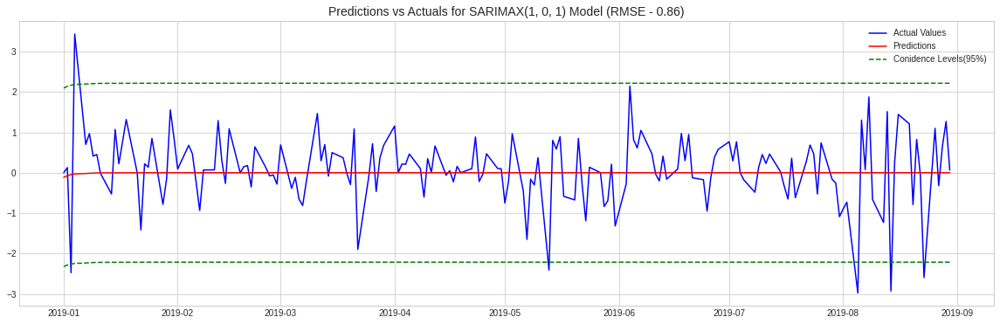

In [55]:
# plot predictions, actuals, and confidence intervals
final_rmse = forecast_accuracy(final_predictions_df["Predictions"], test_df["Return"])["rmse"]

plt.figure(figsize=(20,6))
plt.plot(test_df["Return"][start_date:end_date], color = "blue", label = "Actual Values")

plt.plot(final_predictions_df["Predictions"][start_date:end_date], color = "red", label = "Predictions")
plt.plot(final_predictions_df["upper Return"][start_date:end_date], color = "green", linestyle = "--", label = "Conidence Levels(95%)")
plt.plot(final_predictions_df["lower Return"][start_date:end_date], color = "green", linestyle = "--")

plt.title(f"Predictions vs Actuals for SARIMAX(1, 0, 1) Model (RMSE - {round(final_rmse, 2)})", size = 14)

plt.legend()
plt.show()

# 4) Variance/Volatility Forecasting (GARCH)

Looking at the PACF plots for returns and Volatility, it is clear that the first 2 lags are very significant and then the significance levels drop significantly. So we will build a GARCH(2, 2) Model.

## 4.1) Estimate initial parameters

The PACF (Partial Auto-Correlation Function) plot is used to get an initial estimate of the parameters: p and q of the GARCH model. The number of significant lags in this plot is used as the initial parameters. Then the model summary table (displayed after fitting the model) is used to understand which coefficients in the model are significant. Based on this, the model is fine tuned.

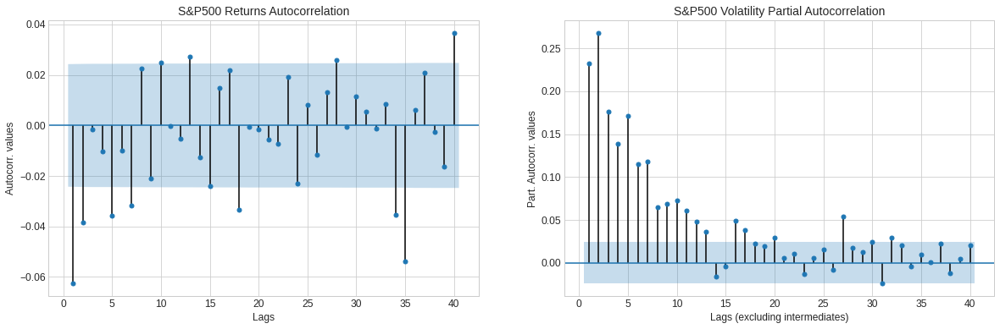

In [56]:
# autocorrelation & partial autocorrelation for last 40 days
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20, 6))

# returns PACF
plot_acf(train_df["Return"][1:].tolist(), zero=False, lags=40, ax=axes[0])
axes[0].set_title("S&P500 Returns Autocorrelation", fontsize=14)
axes[0].set_xlabel('Lags', fontsize=12)
axes[0].set_ylabel('Autocorr. values', fontsize=12)
plt.setp(axes[0].get_xticklabels(), fontsize=12)
plt.setp(axes[0].get_yticklabels(), fontsize=12)
# volatility PACF
plot_pacf(train_df["Volatility"][1:].tolist(), zero=False, lags=40, ax=axes[1])
axes[1].set_title("S&P500 Volatility Partial Autocorrelation", fontsize=14)
axes[1].set_xlabel('Lags (excluding intermediates)', fontsize=12)
axes[1].set_ylabel('Part. Autocorr. values', fontsize=12)
plt.setp(axes[1].get_xticklabels(), fontsize=12)
plt.setp(axes[1].get_yticklabels(), fontsize=12)

plt.show()

Looking at the PACF plots for returns and Volatility, it is clear that the first 2 lags are very significant and then the significance levels drop significantly. So we will build a GARCH(2, 2) Model.

## 4.2) GARCH(2, 2) Model

Before fitting the model, a new dataframe is prepared. This dataframe consists of all the time steps in the original dataset (before train-test split). The training time steps are occupied by the Returns of S&P 500. These are actually used for training the GARCH model. The testing periods are occupied by the Returns observed one time step previously. This is tantamount to saying that the model will forecast tomorrow’s volatility in returns using the returns observed today.

Whenever the predicted volatility of the model spikes violently, the magnitude of returns (heuristically calculated volatility) also fluctuates greatly. On the other hand, when the predicted volatility is stable, then the magnitude of returns are also relatively stable. Thus our model is clearly able to identify periods of high and low volatility in S&P 500 Returns.

The primary purpose of this model is to identify periods where the market is stable and periods where the market is volatile, and the model is successful in capturing this information. Thus, there is no reason to evaluate the model on error metrics like RMSE (Root Mean Squared Error)

In [57]:
garch_df = pd.DataFrame(sp500_df["Return"].shift(1).loc[sp500_df.index])
garch_df.at[train_df.index, "Return"] = train_df["Return"]
garch_df

,Return
Date,
1994-01-06,NaN
1994-01-07,0.595136
1994-01-10,1.142795
1994-01-11,-0.239860
1994-01-12,0.008438
...,...
2019-08-26,-2.594634
2019-08-27,1.098299
2019-08-28,-0.320318


In [58]:
# build model
model = arch_model(garch_df["Return"][1:], p=2, q=2, vol="GARCH")
model_results = model.fit(last_obs=test_df.index[0], update_freq=5)

Iteration:      5,   Func. Count:     53,   Neg. LLF: 8630.607722955368
Iteration:     10,   Func. Count:     99,   Neg. LLF: 8627.660206644487
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 8627.645162302724
            Iterations: 14
            Function evaluations: 133
            Gradient evaluations: 14


In [59]:
# show summary statistics
print(model_results.summary())

                     Constant Mean - GARCH Model Results                      
Dep. Variable:                 Return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:               -8627.65
Distribution:                  Normal   AIC:                           17267.3
Method:            Maximum Likelihood   BIC:                           17308.0
                                        No. Observations:                 6517
Date:                Mon, Aug 23 2021   Df Residuals:                     6516
Time:                        18:02:45   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------------------------------
mu             0.0628  9.674e-03      6.491  8.516e-11 [4.

In [60]:
predictions_df = test_df.copy()
predictions_df["Predictions"] = model_results.forecast().residual_variance.loc[test_df.index]

/usr/local/lib/python3.7/dist-packages/arch/__future__/_utility.py:21: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  FutureWarning,


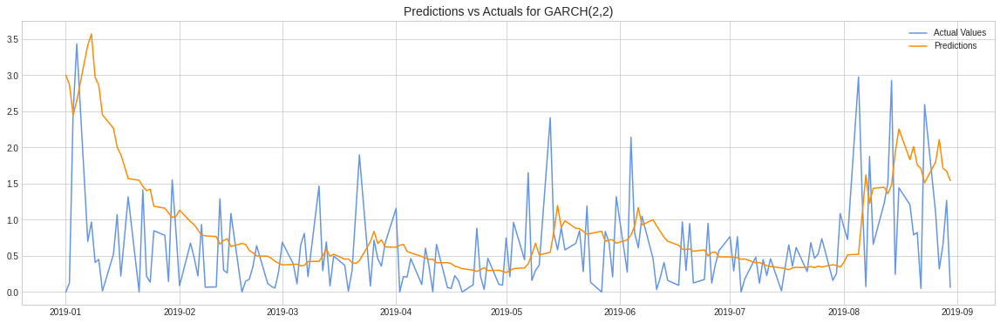

In [61]:
# plot predictions and actuals
plt.figure(figsize=(20,6))
plt.plot(predictions_df["Return"].abs(), color = "cornflowerblue", label = "Actual Values")
plt.plot(predictions_df["Predictions"], color = "darkorange", label = "Predictions")
plt.title("Predictions vs Actuals for GARCH(2,2)", size = 14)
plt.legend()
plt.show()

In [62]:
forecast_accuracy(predictions_df["Predictions"], predictions_df["Return"].abs())

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:662: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:671: FutureWarning: fft=True will become the default after the release of the 0.12 release of statsmodels. To suppress this warning, explicitly set fft=False.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before 

mape           inf
me        0.268553
mae       0.579130
mpe            inf
mse       0.706348
rmse      0.840445
acf1      0.330657
corr      0.226270
minmax    0.526812
dtype: float64

# 5) ARMA + GARCH Model

On examining the plots, it is clear that the first 2 lags are significant in both the plots. After these, the significance level shuts off abruptly and then spikes up again. Thus, to keep the model simple, it is reasonable to set the initial parameters as:

- p = 1, or p = 2
- q = 1, or q = 2

On examining the final ARMA+GARCH plot, it is clear that when the returns are stable, and when the predictions are close to actual returns, the confidence intervals reflect this by being close. Same is true for when the Returns are unstable and the predictions are far from the Returns. In this case too the confidence intervals adjust and become far apart. Thus, using the combination of ARMA and GARCH models we are able to build much more meaningful forecasts. Looking at the forecasts and confidence intervals we can understand the ballpark figure for future returns and also the stability in the market. 


## 5.1) Fit ARMA(1, 1) Model on Returns

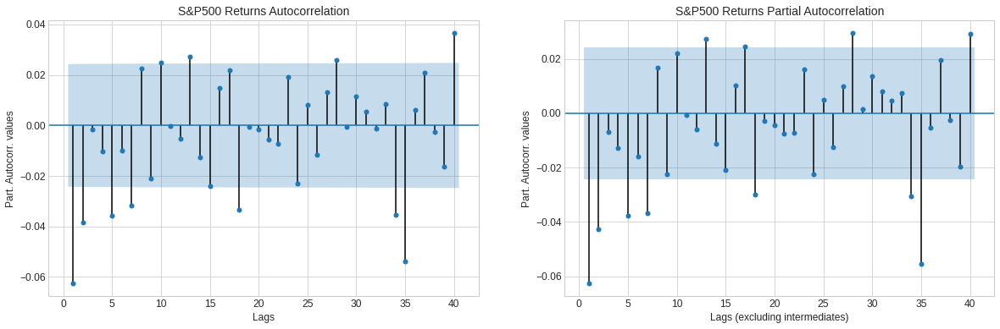

In [63]:
# estimate initial parameters
# autocorrelation & partial autocorrelation for last 40 days
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20, 6))

# close autocorrelation
plot_acf(train_df["Return"][1:].tolist(), zero=False, lags=40, ax=axes[0])
axes[0].set_title("S&P500 Returns Autocorrelation", fontsize=14)
axes[0].set_xlabel('Lags', fontsize=12)
axes[0].set_ylabel('Part. Autocorr. values', fontsize=12)
plt.setp(axes[0].get_xticklabels(), fontsize=12)
plt.setp(axes[0].get_yticklabels(), fontsize=12)
# close partial autocorrelation
plot_pacf(train_df["Return"][1:].tolist(), zero=False, lags=40, ax=axes[1])
axes[1].set_title("S&P500 Returns Partial Autocorrelation", fontsize=14)
axes[1].set_xlabel('Lags (excluding intermediates)', fontsize=12)
axes[1].set_ylabel('Part. Autocorr. values', fontsize=12)
plt.setp(axes[1].get_xticklabels(), fontsize=12)
plt.setp(axes[1].get_yticklabels(), fontsize=12)

plt.show()

In [64]:
# build ARMA model
arma_model = SARIMAX(train_df["Return"][1:], order = (1, 0, 1))
arma_model_results = arma_model.fit()
print(arma_model_results.summary())

                               SARIMAX Results                                
Dep. Variable:                 Return   No. Observations:                 6517
Model:               SARIMAX(1, 0, 1)   Log Likelihood              -10024.948
Date:                Mon, 23 Aug 2021   AIC                          20055.897
Time:                        18:02:47   BIC                          20076.243
Sample:                    01-07-1994   HQIC                         20062.933
                         - 12-31-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6462      0.047     13.689      0.000       0.554       0.739
ma.L1         -0.7075      0.043    -16.560      0.000      -0.791      -0.624
sigma2         1.2696      0.010    128.105      0.0

In [65]:
# set prediction interval
start_date = test_df.index[0]
end_date = test_df.index[-1]

In [66]:
# predictions
arma_forecast = arma_model_results.get_forecast(len(test_df.index))
arma_predictions_df = arma_forecast.conf_int(alpha = 0.05) # Confidence level of 95%
arma_predictions_df["Predictions"] = arma_model_results.predict(start = start_date, end = end_date)

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:662: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:671: FutureWarning: fft=True will become the default after the release of the 0.12 release of statsmodels. To suppress this warning, explicitly set fft=False.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before 

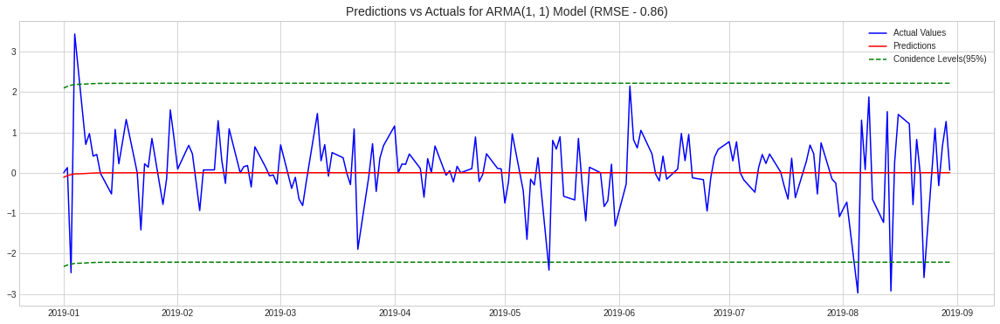

In [67]:
# plot predictions, actuals, and confidence intervals
arma_rmse = forecast_accuracy(final_predictions_df["Predictions"], test_df["Return"])["rmse"]

plt.figure(figsize=(20,6))
plt.plot(test_df["Return"][start_date:end_date], color = "blue", label = "Actual Values")

plt.plot(arma_predictions_df["Predictions"][start_date:end_date], color = "red", label = "Predictions")
plt.plot(arma_predictions_df["upper Return"][start_date:end_date], color = "green", linestyle = "--", label = "Conidence Levels(95%)")
plt.plot(arma_predictions_df["lower Return"][start_date:end_date], color = "green", linestyle = "--")

plt.title(f"Predictions vs Actuals for ARMA(1, 1) Model (RMSE - {round(final_rmse, 2)})", size = 14)

plt.legend()
plt.show()

On inspecting the plot (shown in the image), the predictions are in some cases spot on, and in some cases they are wrong by huge margins. The confidence intervals do nothing to indicate how the predictions will perform in different time periods of the test set. In some cases the confidence intervals seem too conservative, and the returns overshoot the boundaries. In other cases, the confidence intervals are not nearly conservative enough. To address this issue, in the next section we will analyse the residuals of the model and try to predict when the ARMA predictions will be off by a small margin and when will they be off by a large margin.

## 5.2) Fit GARCH Model to ARMA Residuals

On examining the plot, it is clear that the residuals show the phenomenon of volatility clustering. This means that if the series shows high volatility (high variance) at a particular time step, then it will show high volatility in nearby time steps as well, and vice versa. In periods around 2004, 2008 (periods of high volatility), and the periods in between(periods of low volatility), this phenomenon is clearly observed. Series that show such volatility clustering can be successfully modeled using the GARCH model.

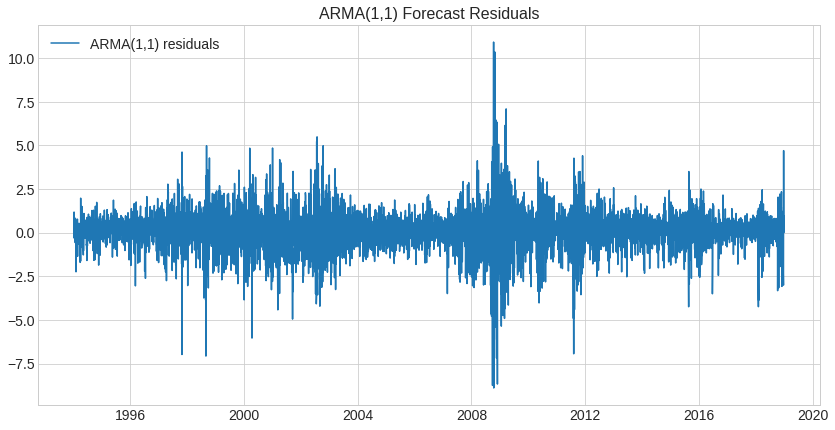

In [68]:
# Plot residuals as line plot
plt.figure(figsize=(14,7))
plt.plot(arma_model_results.resid, label='ARMA(1,1) residuals')
plt.title('ARMA(1,1) Forecast Residuals', fontsize=16)
plt.legend(loc='upper left', fontsize=14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.show()

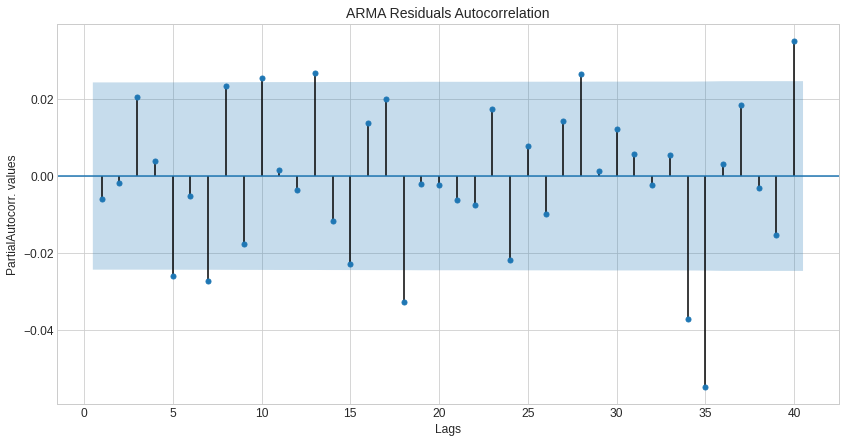

In [69]:
# autocorrelation & partial autocorrelation for last 40 days
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(14, 7))
plot_acf(arma_model_results.resid[1:].tolist(), zero=False, lags=40, ax=axes)
axes.set_title("ARMA Residuals Autocorrelation", fontsize=14)
axes.set_xlabel('Lags', fontsize=12)
axes.set_ylabel('PartialAutocorr. values', fontsize=12)
plt.setp(axes.get_xticklabels(), fontsize=12)
plt.setp(axes.get_yticklabels(), fontsize=12)
plt.show()

The GARCH model, has 2 parameters represented as: GARCH(p, q). These parameters are estimated by counting the number of significant lags in the PACF plot. The plot shows that there are no significant lags in the residuals. Thus we will fit various GARCH models: GARCH(1, 1), GARCH(1, 2), GARCH(2, 1), GARCH(2, 2), etc. till we get a model with significant coefficients and best accuracy.

In [70]:
# prepare df for GARCH model
garch_df = sp500_df.copy()
garch_df["Return_Resid"] = garch_df["Return"].shift(1).loc[garch_df.index]
garch_df.at[train_df.index[1:-1], "Return_Resid"] = arma_model_results.resid

In [71]:
# build GARCH(2,2) model
garch_model = arch_model(garch_df["Return_Resid"][1:], p=2, q=2, vol="GARCH")
garch_model_results = garch_model.fit(last_obs=test_df.index[0], update_freq=5)
print(garch_model_results.summary())

Iteration:      5,   Func. Count:     53,   Neg. LLF: 8624.31665143241
Iteration:     10,   Func. Count:    100,   Neg. LLF: 8620.93709425701
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 8620.87245027112
            Iterations: 14
            Function evaluations: 133
            Gradient evaluations: 14
                     Constant Mean - GARCH Model Results                      
Dep. Variable:           Return_Resid   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:               -8620.87
Distribution:                  Normal   AIC:                           17253.7
Method:            Maximum Likelihood   BIC:                           17294.4
                                        No. Observations:                 6517
Date:                Mon, Aug 23 2021   Df Residuals:                     6516
Time:           

In [72]:
# predictions
garch_forecasts = garch_model_results.forecast().residual_variance.loc[test_df.index].values

/usr/local/lib/python3.7/dist-packages/arch/__future__/_utility.py:21: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  FutureWarning,


## 5.3) ARMA(1,1) Predictions & GARCH(2,2) Confidence Intervals


In [73]:
# ARMA + GARCH predictions
arma_garch_predictions_df = arma_predictions_df.copy()
arma_garch_predictions_df["lower Return"] = arma_garch_predictions_df["Predictions"] - garch_forecasts.reshape(-1,)
arma_garch_predictions_df["upper Return"] = arma_garch_predictions_df["Predictions"] + garch_forecasts.reshape(-1,)

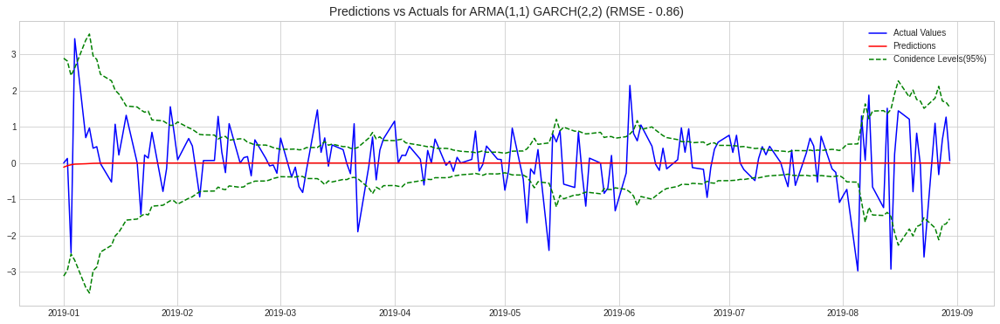

In [74]:
# plot predictions, actuals, and confidence intervals
plt.figure(figsize=(20,6))
plt.plot(test_df["Return"][start_date:end_date], color = "blue", label = "Actual Values")
plt.plot(arma_garch_predictions_df["Predictions"][start_date:end_date], color = "red", label = "Predictions")
plt.plot(arma_garch_predictions_df["upper Return"][start_date:end_date], color = "green", linestyle = "--", label = "Conidence Levels(95%)")
plt.plot(arma_garch_predictions_df["lower Return"][start_date:end_date], color = "green", linestyle = "--")
plt.title(f"Predictions vs Actuals for ARMA(1,1) GARCH(2,2) (RMSE - {round(final_rmse, 2)})", size = 14)
plt.legend()
plt.show()

On examining the plot, it is clear that when the returns are stable, and when the predictions are close to actual returns, the confidence intervals reflect this by being close. Same is true for when the Returns are unstable and the predictions are far from the Returns. In this case too the confidence intervals adjust and become far apart.